# Analyse BlueSeis BSPF Event Analysis - XWT - CWT

In [1]:
import os,sys
import obspy as obs
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [2]:
from functions.compute_cross_wavelet_transform import __compute_cross_wavelet_transform
from functions.compute_wavelet_coherencey_transform import __compute_wavelet_coherency_transform

In [3]:
if os.uname().nodename == 'lighthouse':
    root_path = '/home/andbro/'
    data_path = '/home/andbro/kilauea-data/'
    archive_path = '/home/andbro/freenas/'
elif os.uname().nodename == 'kilauea':
    root_path = '/home/brotzer/'
    data_path = '/import/kilauea-data/'
    archive_path = '/import/freenas-ffb-01-data/'

In [4]:
sys.path.append(root_path+"andbro_python/")

from andbro__store_as_pickle import __store_as_pickle
from andbro__savefig import __savefig

## Configurations

In [5]:
config = {}

## BSPF coordinates
config['BSPF_lon'] = -116.455439
config['BSPF_lat'] = 33.610643

##
config['path_to_mseed'] = data_path+"BSPF/data/waveforms/ACC/"

## event selction
config['path_to_data'] = data_path+"BSPF/data/"

## output path for figures
config['output_figs'] = data_path+"BSPF/figures/"


## Load Data

In [6]:
events = obs.read_events(config['path_to_data']+"catalogs/BSPF_catalog_20221001_20230615_all.xml")

triggered = pd.read_pickle(config['path_to_data']+"catalogs/BSPF_catalog_20221001_20230615_triggered.pkl")

event_times = pd.read_pickle(config['path_to_data']+"event_selection_good.pkl")

In [7]:
num = 1

event_time = event_times.origin_time.loc[num]

event = events.filter(f"time >= {event_time}",f"time <= {event_time}")

trig = triggered[triggered.origin == event_time]

## prepare string
event_time_str = event_time.split(".")[0].replace(" ","_").replace("-","").replace(":","")

In [8]:
st = obs.read(config['path_to_mseed']+f"*{event_time_str}*")

st.resample(40).trim(st[0].stats.starttime, st[0].stats.endtime);

st.detrend("linear");

st.filter("bandpass", freqmin=8.0, freqmax=15, corners=4, zerophase=True);

In [9]:
cut_offs = [
    (70,60), (65,80), (60,100), (60,100), (60,70),
    (60,90), (60,90), (60,90), (62,105), (65,90),
    (62,110), (65,85), (60,105), (63,105), (66,90),
    (60,90), (65,90), (70,95),
]

# st.trim(st[0].stats.starttime+cut_offs[num][0]-10, st[0].stats.endtime-cut_offs[num][1]+10);
st.trim(st[0].stats.starttime+cut_offs[num][0], st[0].stats.endtime-cut_offs[num][1]);

In [10]:
# st.plot(equal_scale=False);

## Cross Wavelet Transform

In [11]:
rot = st.copy().select(station="BSPF")
adr = st.copy().select(station="RPFO", location="in")
# acc = st.copy().select(station="PFO*")

/home/brotzer/notebooks/BSPF/functions/compute_cross_wavelet_transform.py:96: RuntimeWarning: Mean of empty slice
  global_xwt_f = nanmean(xwt_power_masked, axis=1)


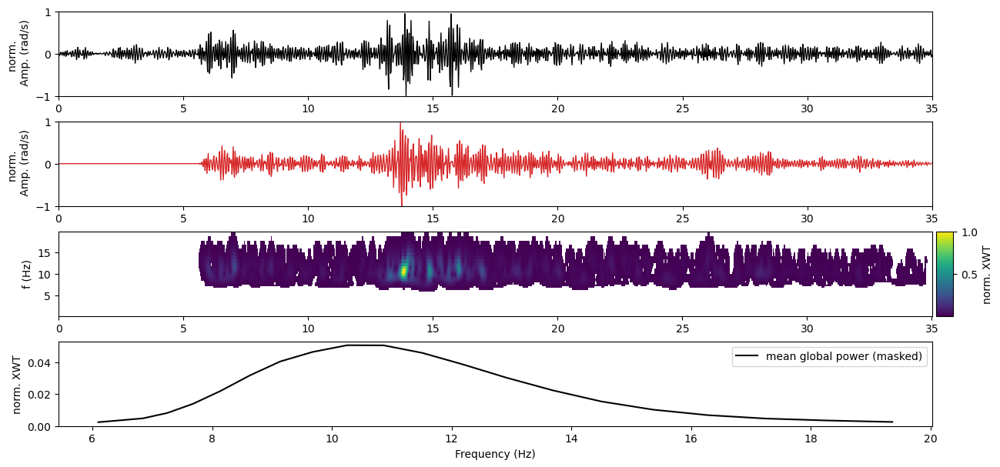

In [12]:
# , vmin=0, vmax=1
comp = "Z"
out = __compute_cross_wavelet_transform(rot.select(channel=f"*{comp}")[0].times(),
                                        rot.select(channel=f"*{comp}")[0].data,
                                        adr.select(channel=f"*{comp}")[0].data,
                                        rot.select(channel=f"*{comp}")[0].stats.delta,
                                        xwt_threshold=0.1,
                                        normalize=True,
                                        plot=True,
                                       )

## AS LOOP

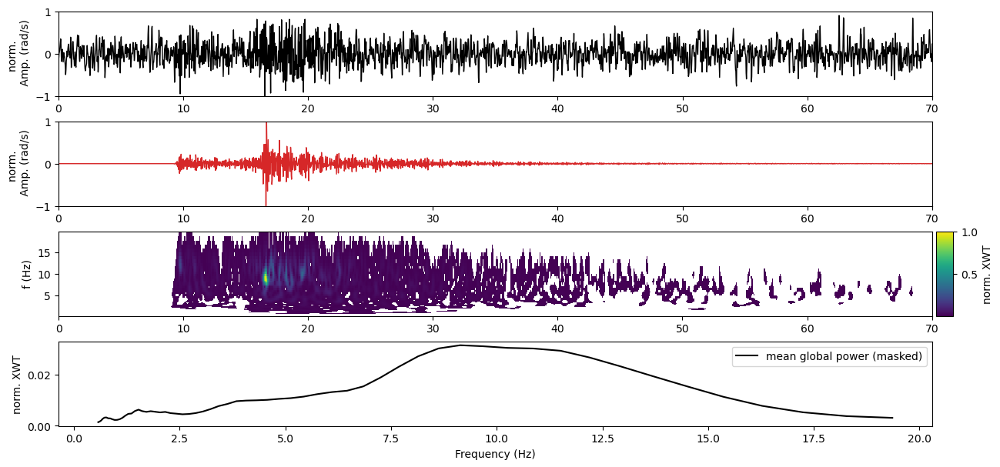


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221003_160809_xwt_Z.png ...

   -> Done



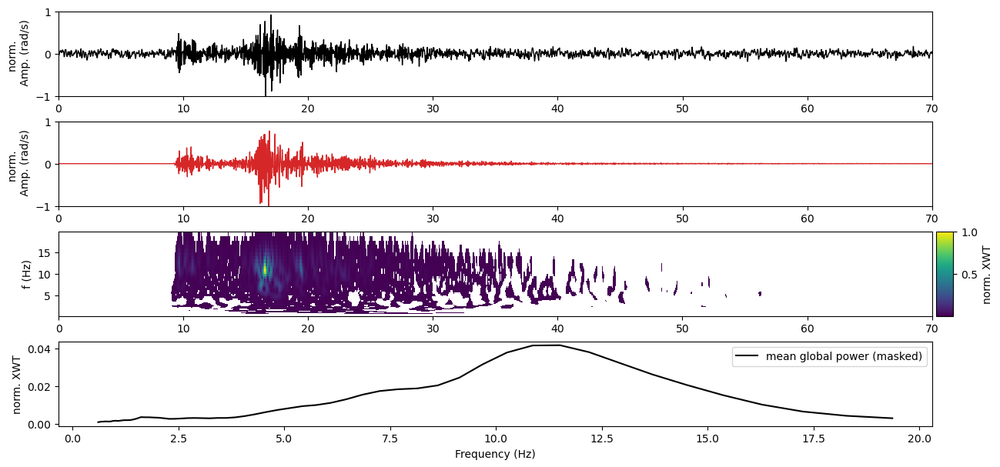


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221003_160809_xwt_N.png ...

   -> Done



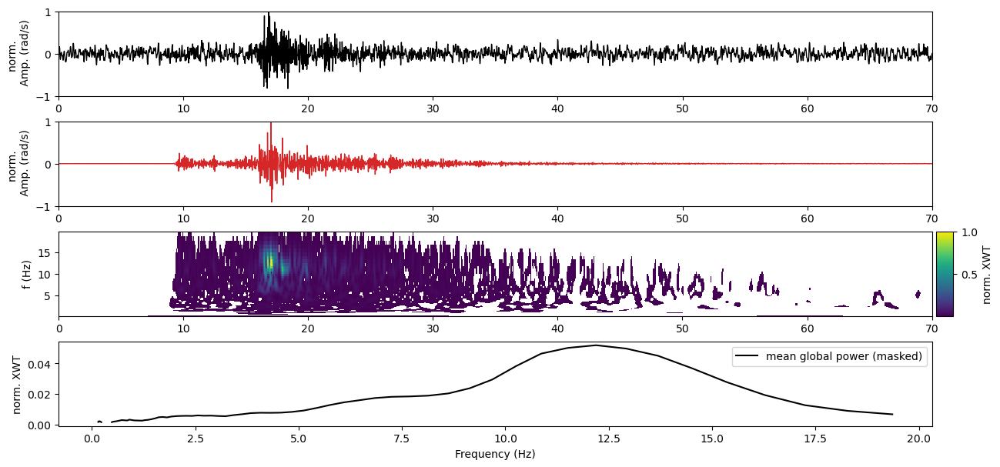


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221003_160809_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.0618347182567268 0.005174599592396822


/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/pycwt/wavelet.py:633: RuntimeWarning: invalid value encountered in arctanh
  aa = numpy.round(numpy.arctanh(numpy.array([al1, al2]) * 4))
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/pycwt/wavelet.py:254: RuntimeWarning: invalid value encountered in log2
  dj = numpy.log2(scales[1] / scales[0])
/home/brotzer/notebooks/BSPF/functions/compute_wavelet_coherencey_transform.py:119: RuntimeWarning: Mean of empty slice
  global_power_t = nan_to_num(nanmean(wct_power_masked,axis=0), nan=0)


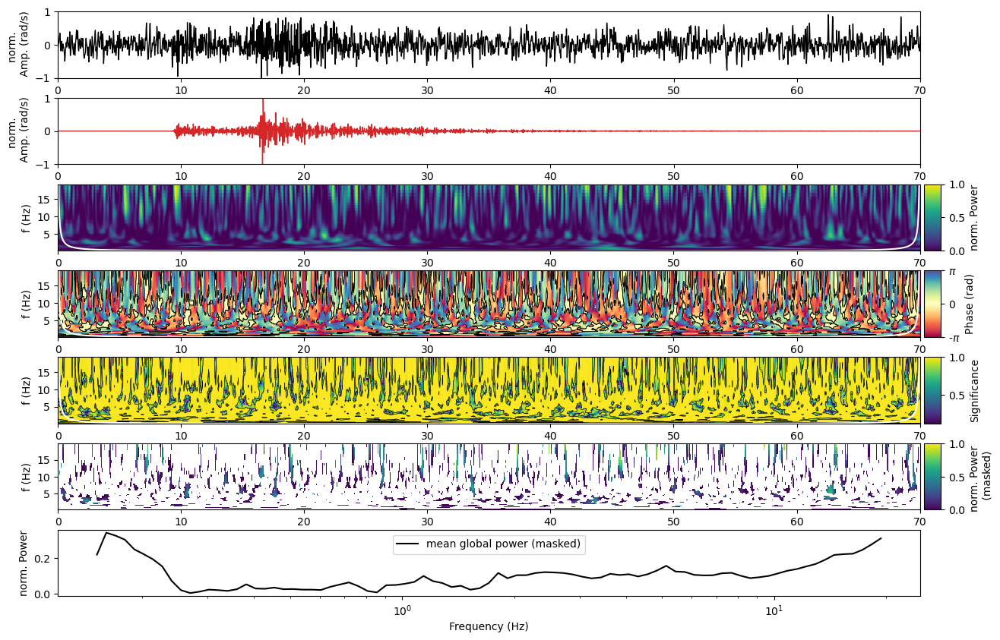


   -> saving /import/kilauea-data/BSPF/figures/wct/20221003_160809_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.011961223160033856 0.007742288687325333


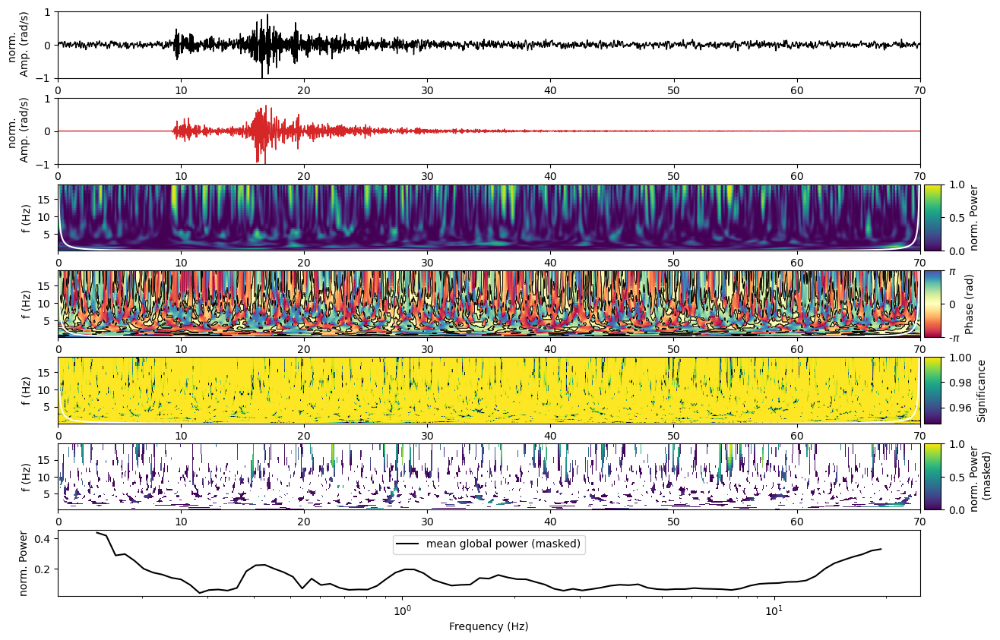


   -> saving /import/kilauea-data/BSPF/figures/wct/20221003_160809_wct_N.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [04:05<00:00,  1.22it/s]


0.016865155583357976 0.0052019217789166985


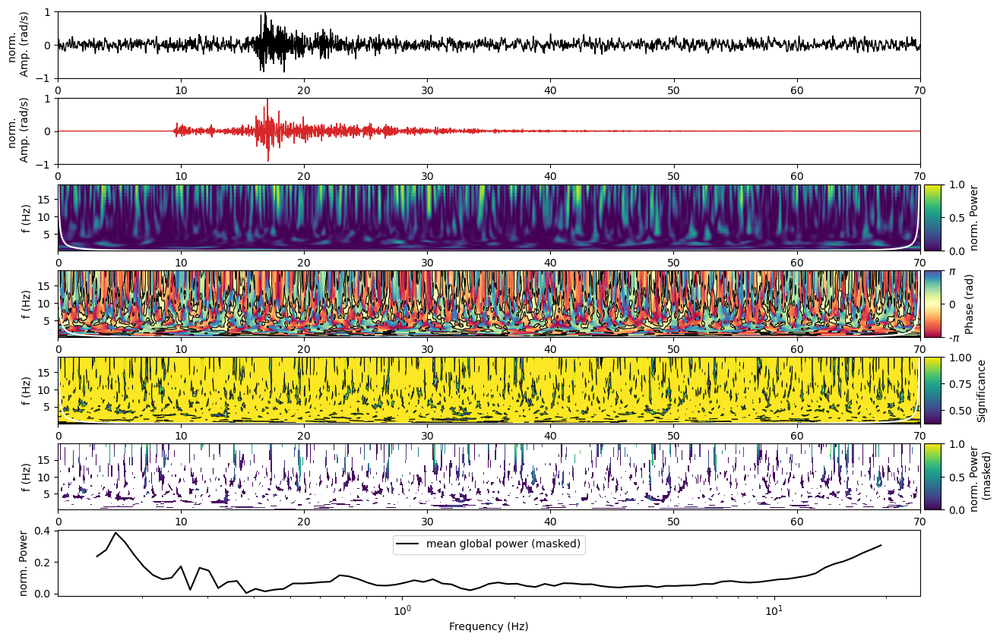


   -> saving /import/kilauea-data/BSPF/figures/wct/20221003_160809_wct_E.png ...

   -> Done



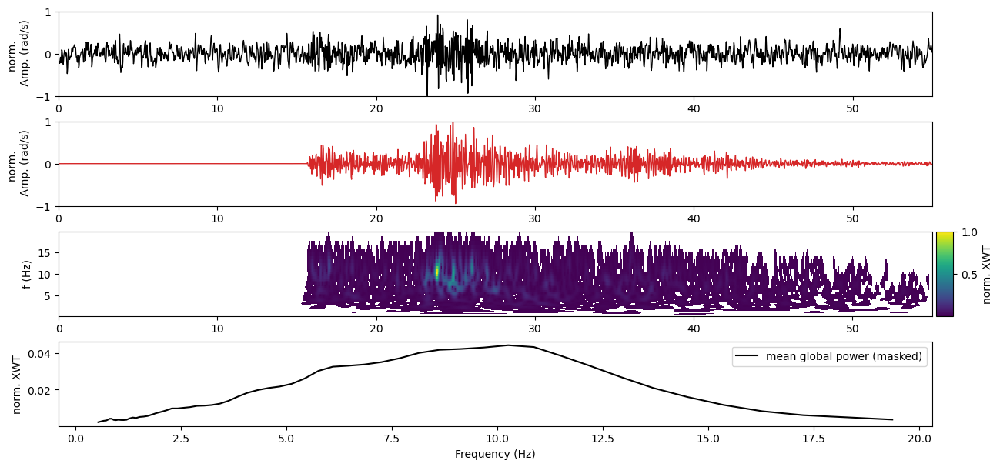


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221007_224505_xwt_Z.png ...

   -> Done



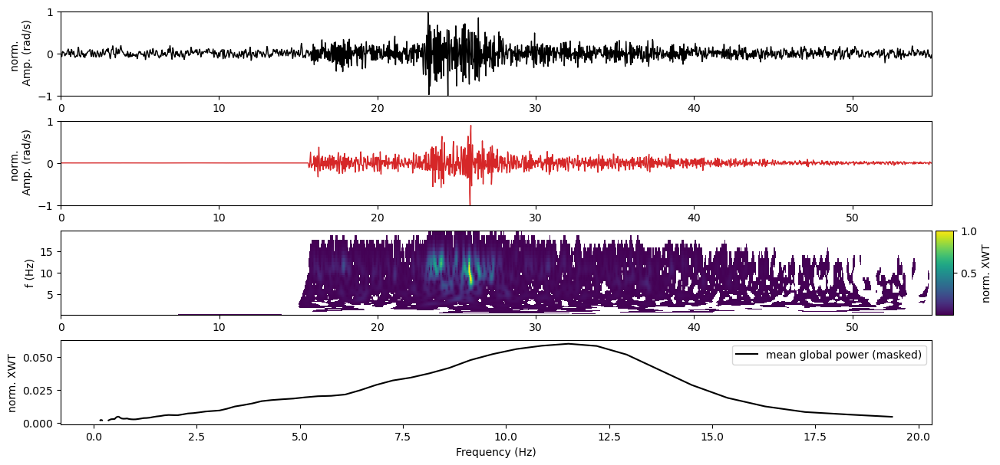


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221007_224505_xwt_N.png ...

   -> Done



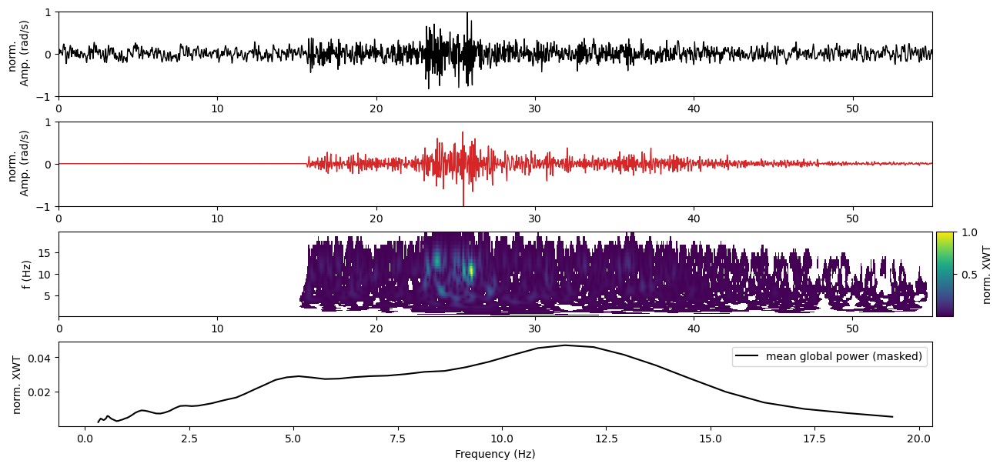


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221007_224505_xwt_E.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [04:03<00:00,  1.23it/s]


0.03387233389568868 0.02438998736898628


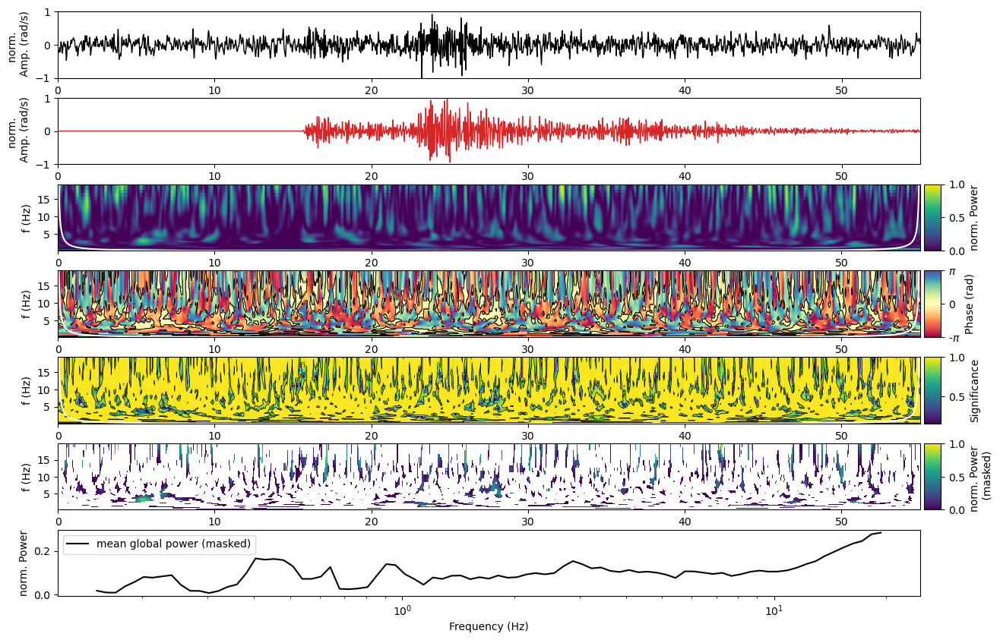


   -> saving /import/kilauea-data/BSPF/figures/wct/20221007_224505_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.02117544738289046 0.010180201455753232


/home/brotzer/notebooks/BSPF/functions/compute_wavelet_coherencey_transform.py:118: RuntimeWarning: Mean of empty slice
  global_power_f = nan_to_num(nanmean(wct_power_masked,axis=1), nan=0)


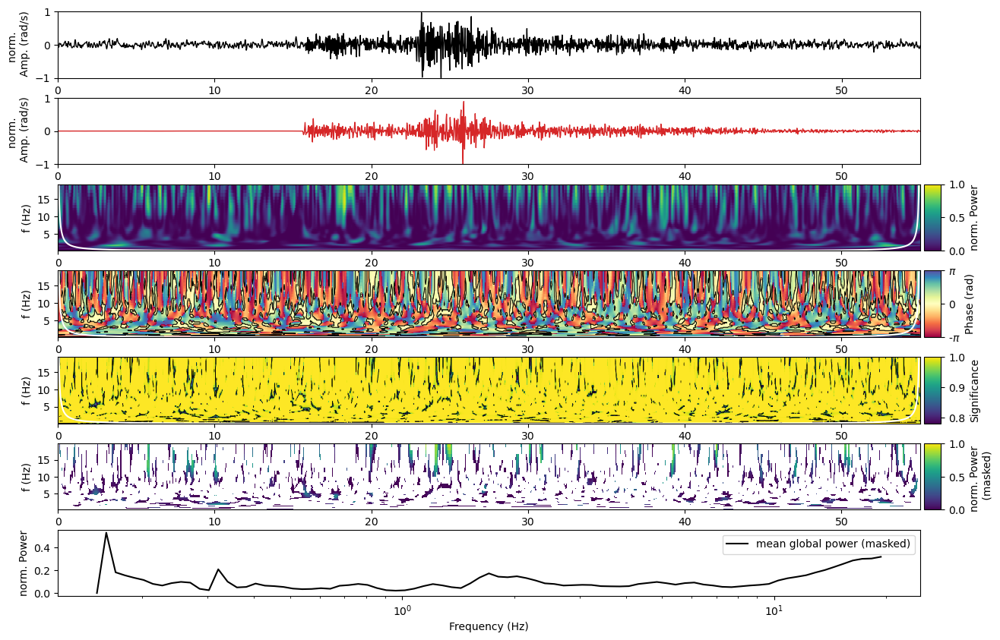


   -> saving /import/kilauea-data/BSPF/figures/wct/20221007_224505_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.02098472385081739 0.010468011794990052


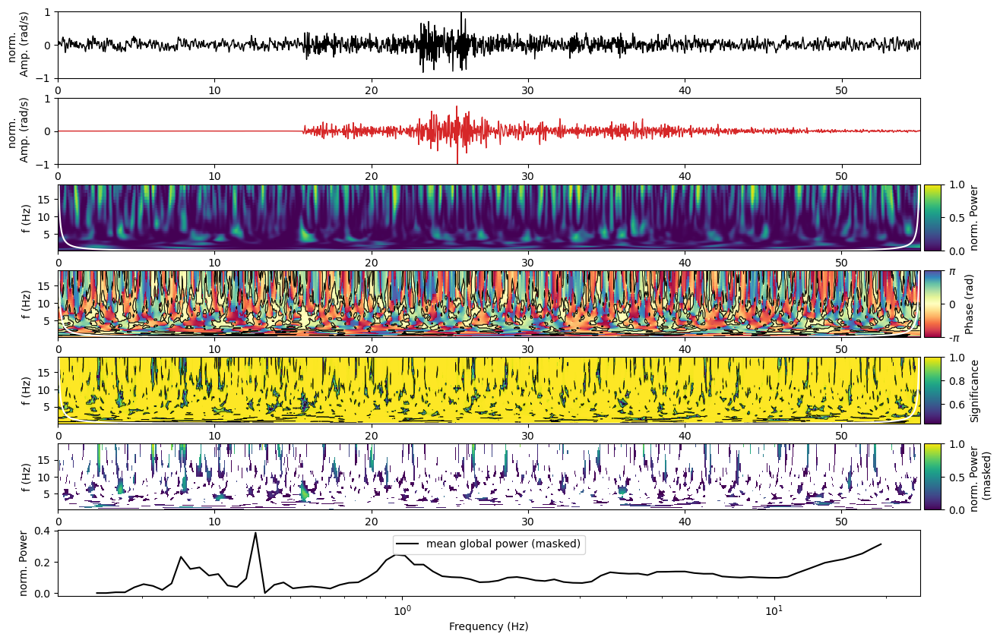


   -> saving /import/kilauea-data/BSPF/figures/wct/20221007_224505_wct_E.png ...

   -> Done



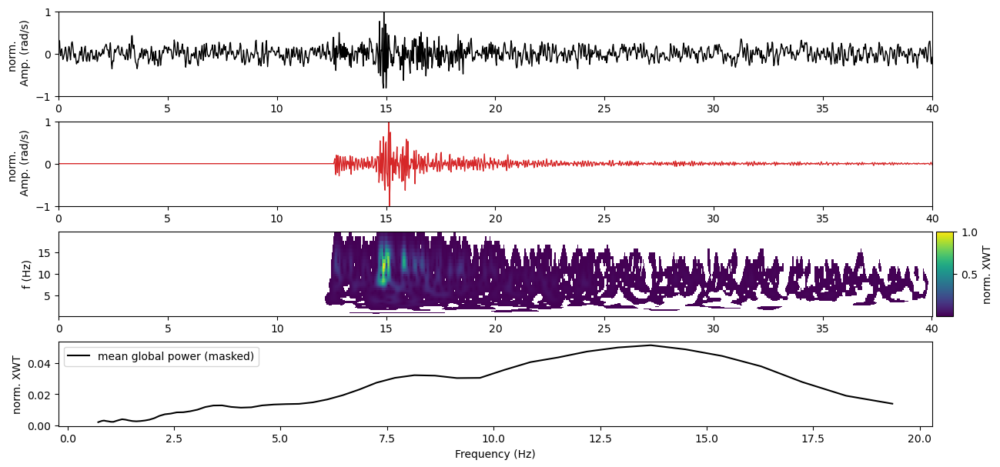


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221015_051734_xwt_Z.png ...

   -> Done



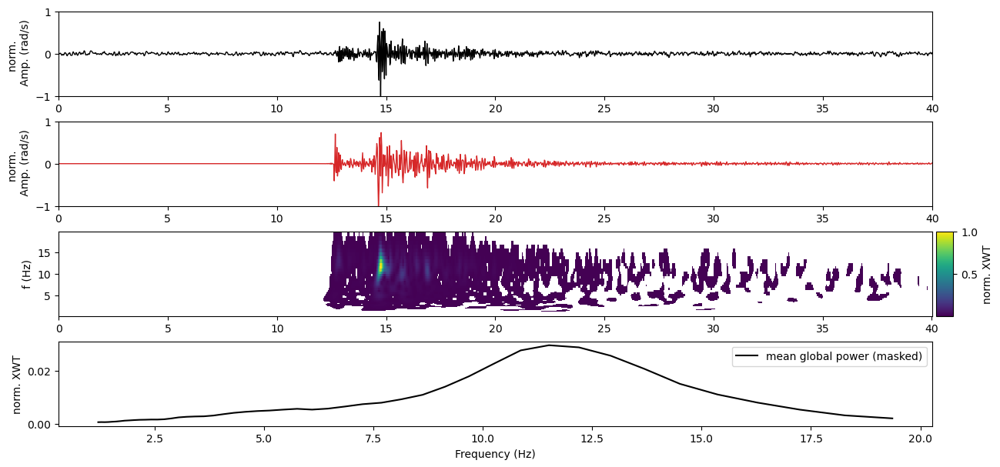


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221015_051734_xwt_N.png ...

   -> Done



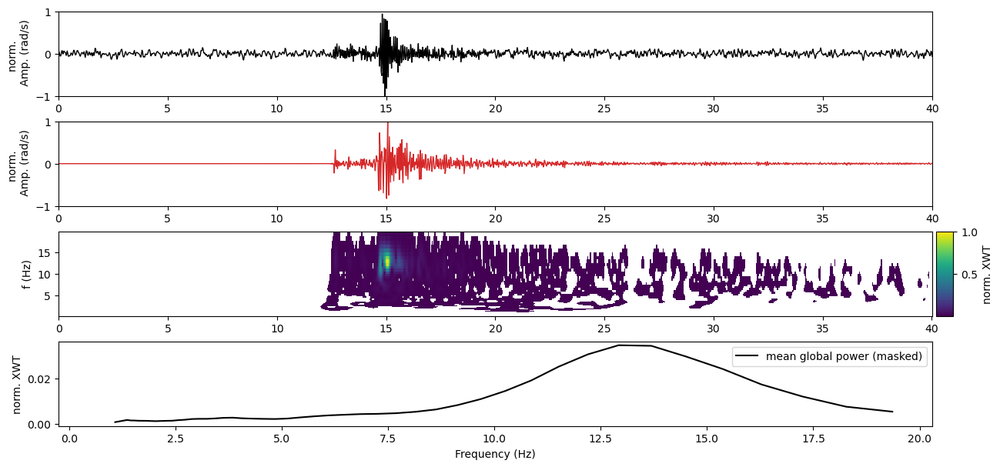


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221015_051734_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.024666265923904293 0.007977938018367532


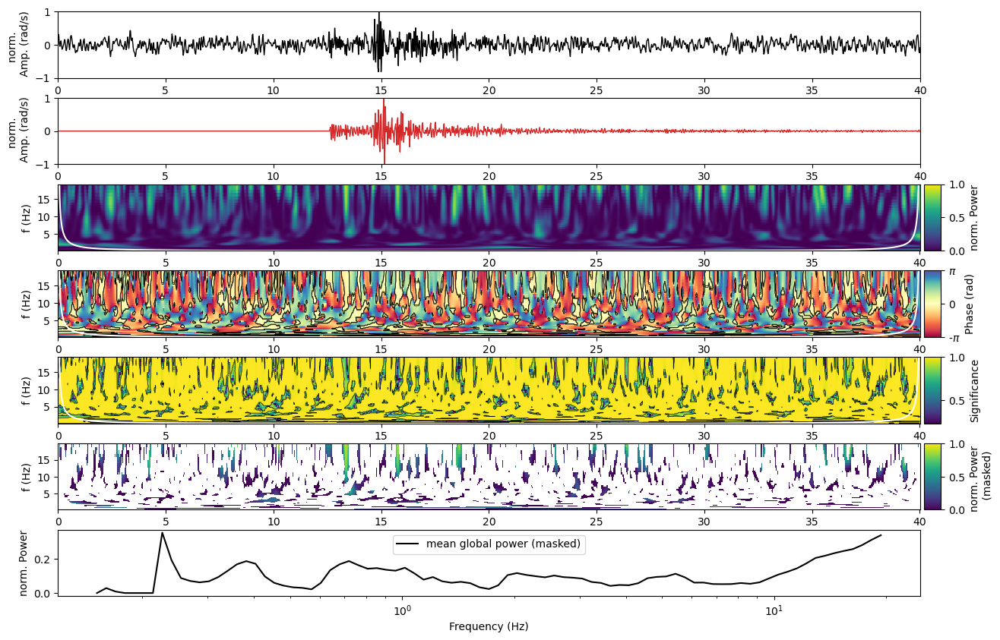


   -> saving /import/kilauea-data/BSPF/figures/wct/20221015_051734_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.004919069173177805 0.007228250723815256


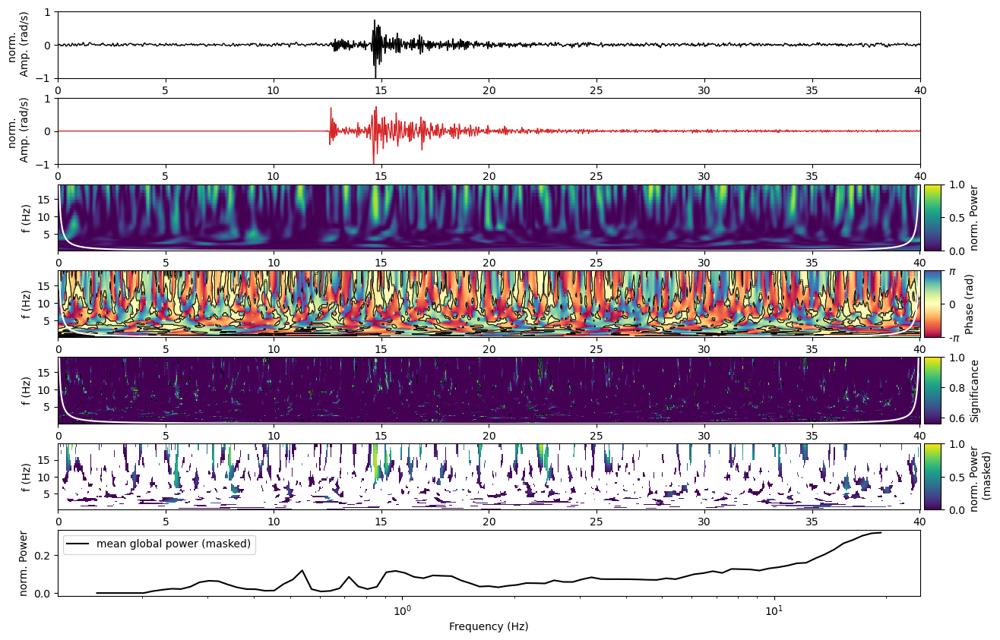


   -> saving /import/kilauea-data/BSPF/figures/wct/20221015_051734_wct_N.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [03:58<00:00,  1.26it/s]


0.008414699808579425 0.007148367495532384


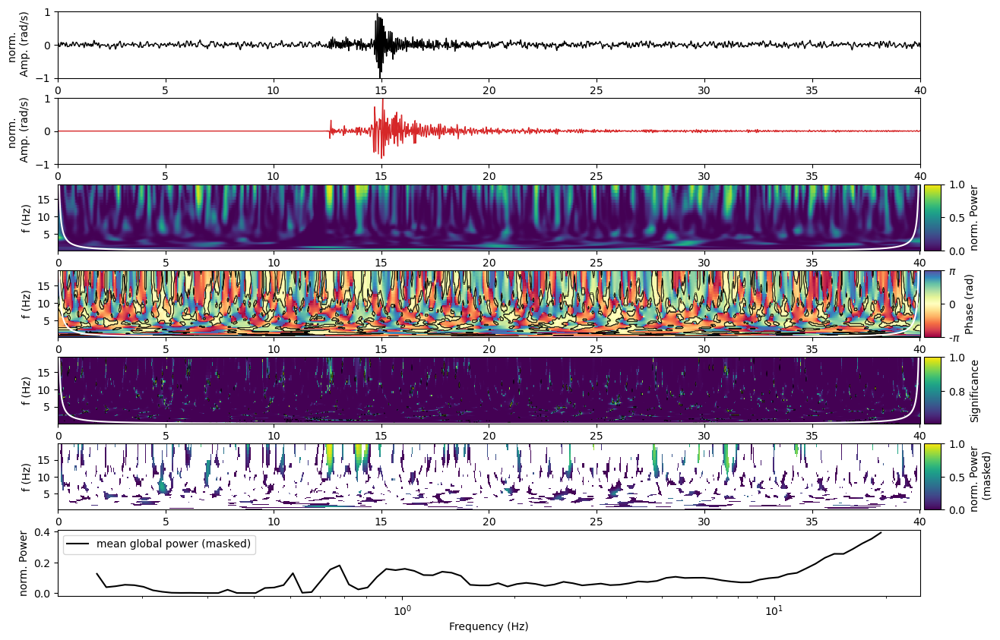


   -> saving /import/kilauea-data/BSPF/figures/wct/20221015_051734_wct_E.png ...

   -> Done



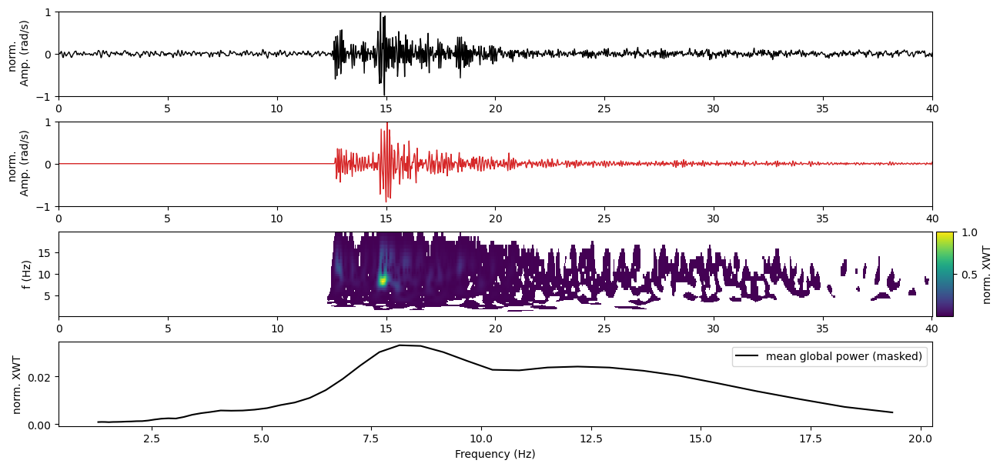


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221023_092458_xwt_Z.png ...

   -> Done



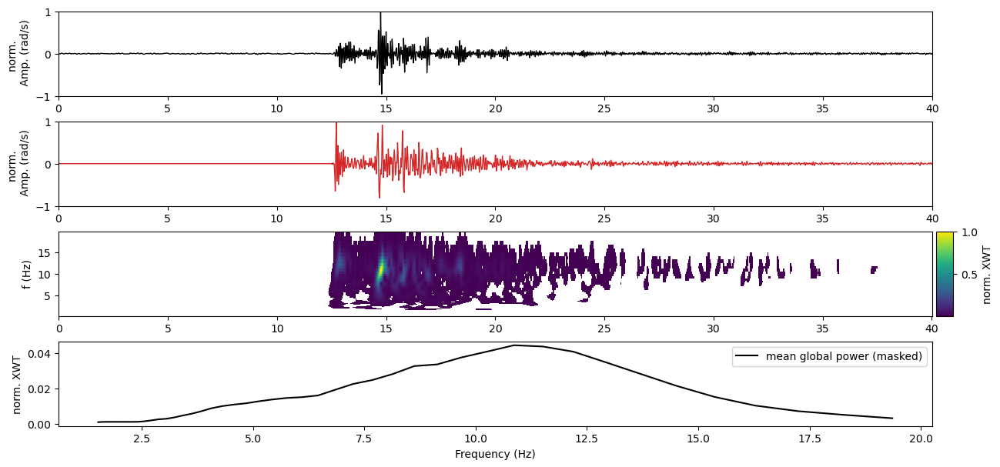


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221023_092458_xwt_N.png ...

   -> Done



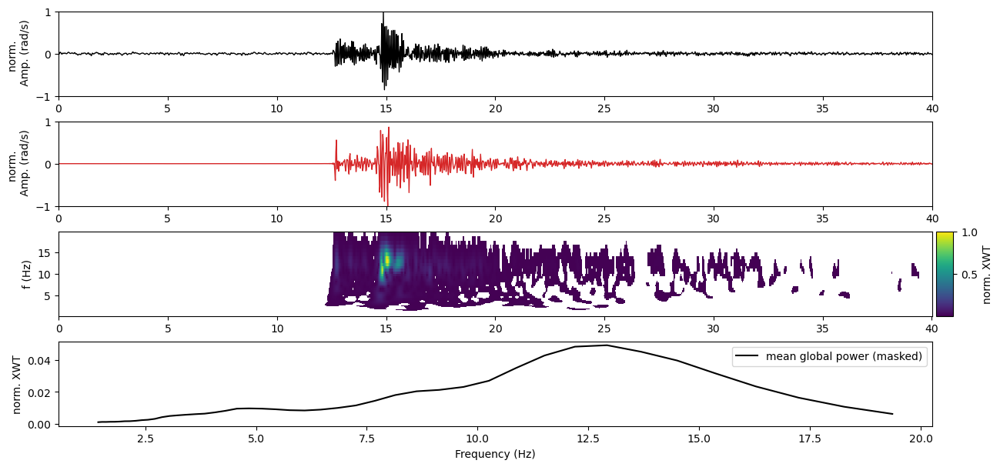


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221023_092458_xwt_E.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [03:57<00:00,  1.26it/s]


0.012549742882212658 0.009834478272076907


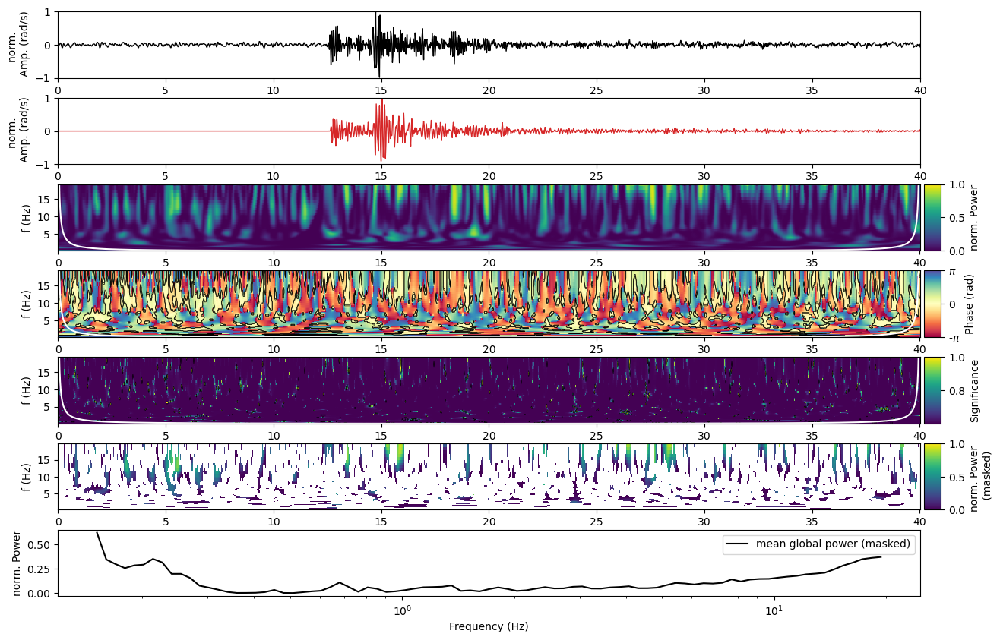


   -> saving /import/kilauea-data/BSPF/figures/wct/20221023_092458_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.006153730788864591 0.009771692466915333


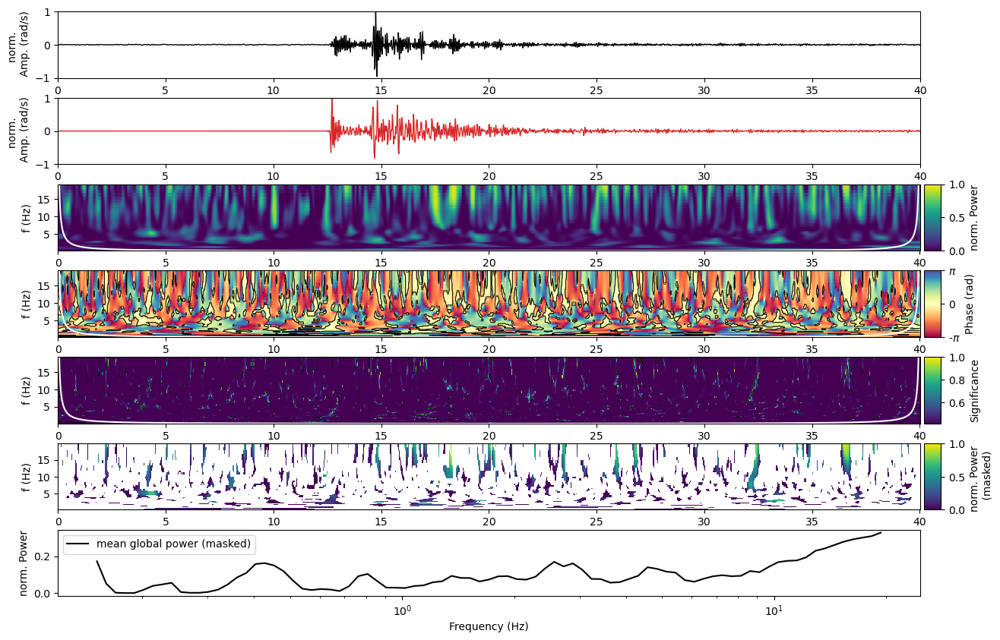


   -> saving /import/kilauea-data/BSPF/figures/wct/20221023_092458_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.00786760155983211 0.010688054706934702


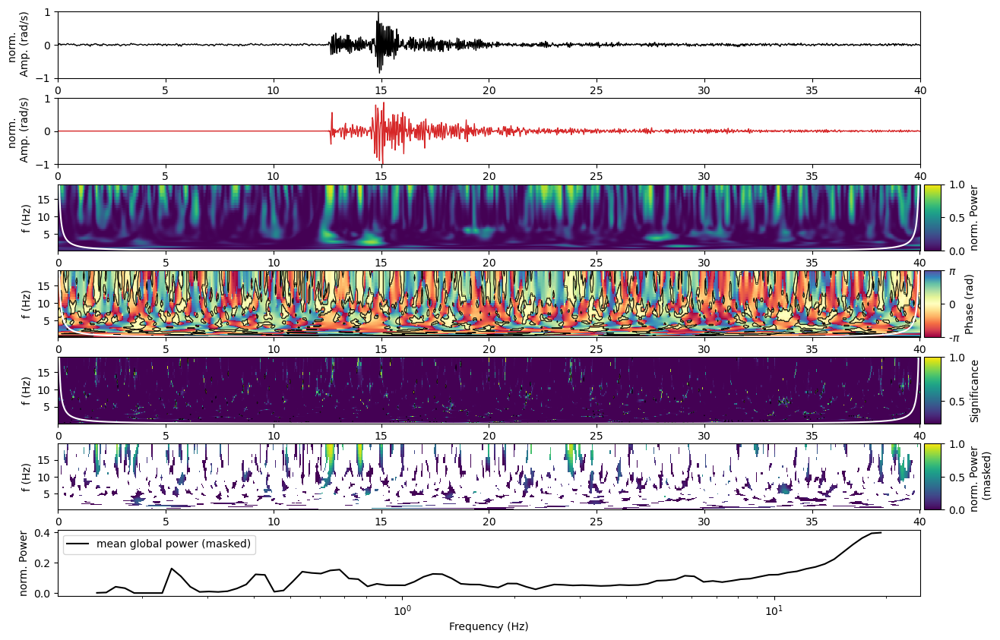


   -> saving /import/kilauea-data/BSPF/figures/wct/20221023_092458_wct_E.png ...

   -> Done



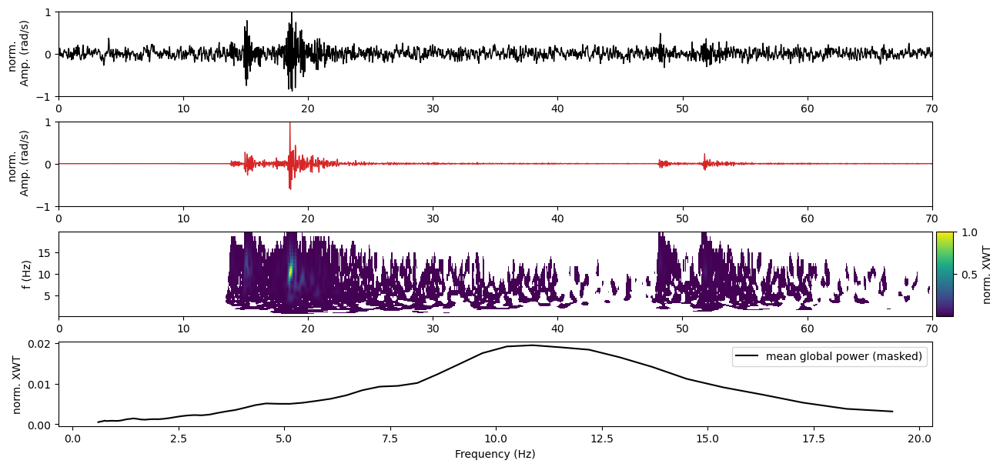


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221026_081435_xwt_Z.png ...

   -> Done



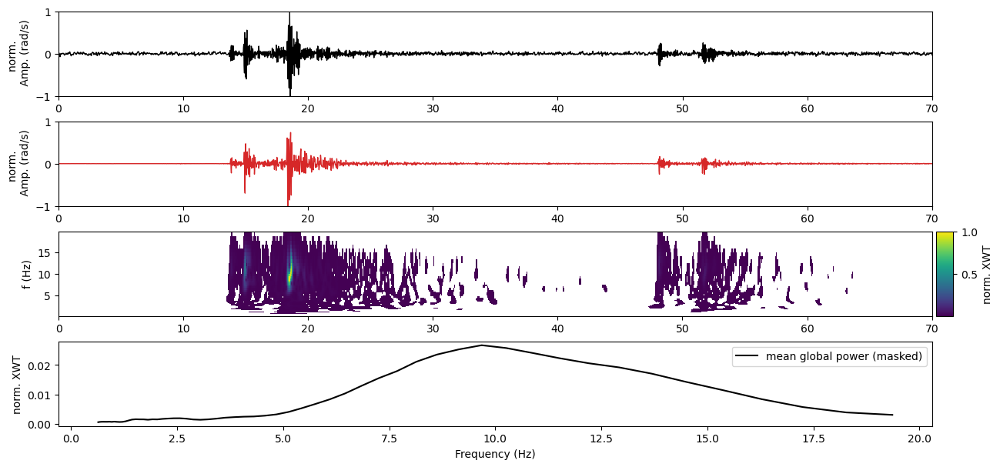


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221026_081435_xwt_N.png ...

   -> Done



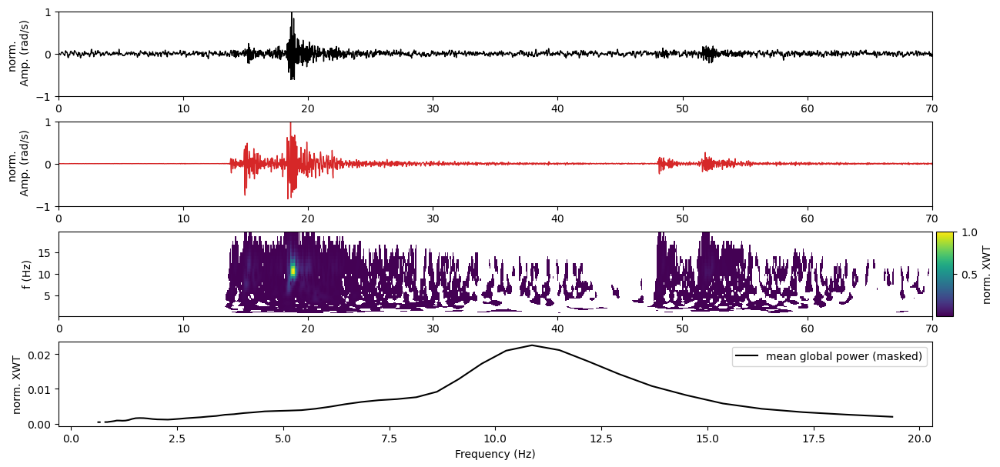


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221026_081435_xwt_E.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [03:59<00:00,  1.25it/s]


0.014476533165133528 0.0017881739824377582


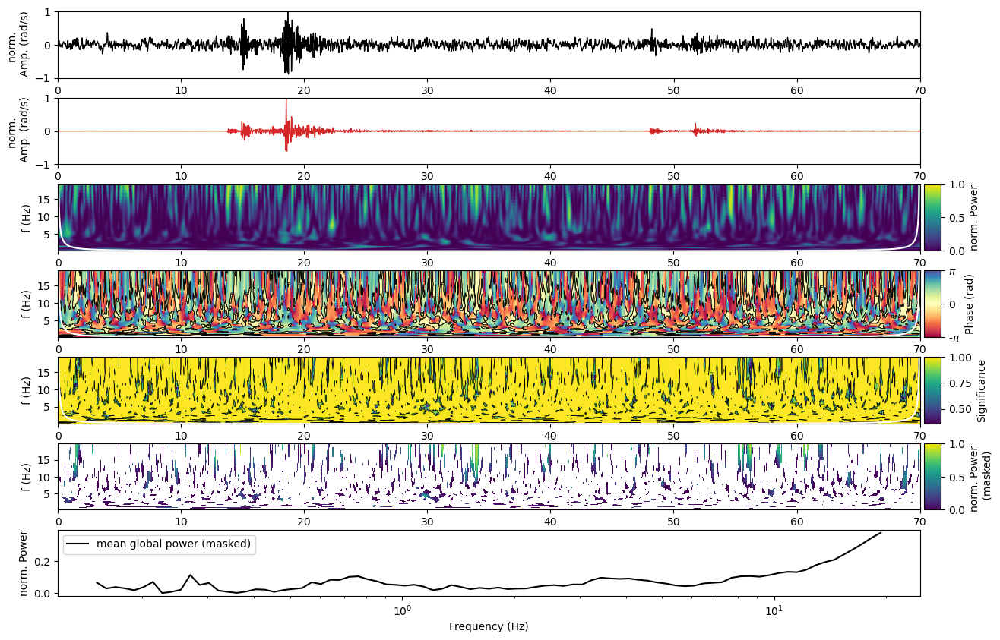


   -> saving /import/kilauea-data/BSPF/figures/wct/20221026_081435_wct_Z.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [03:59<00:00,  1.25it/s]


0.005122841984977644 0.0037804826212245323


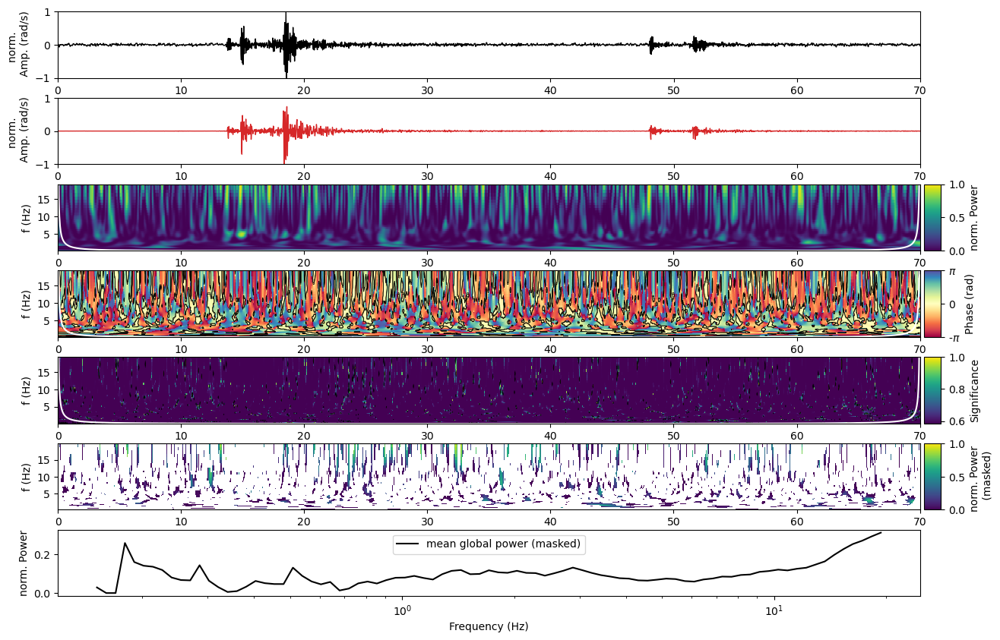


   -> saving /import/kilauea-data/BSPF/figures/wct/20221026_081435_wct_N.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [04:00<00:00,  1.25it/s]


0.004350204407620908 0.006431951112895179


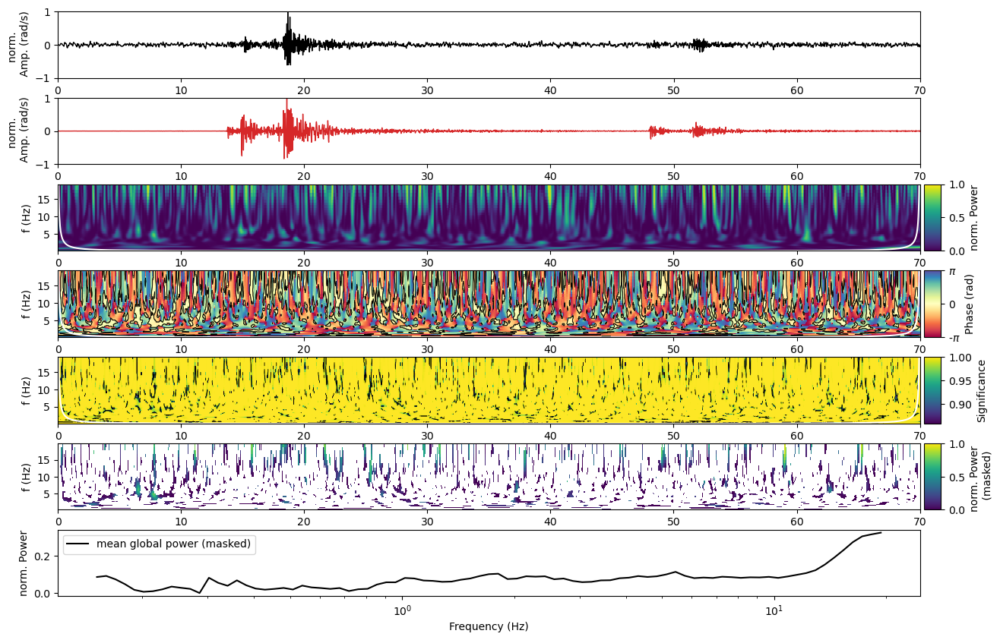


   -> saving /import/kilauea-data/BSPF/figures/wct/20221026_081435_wct_E.png ...

   -> Done



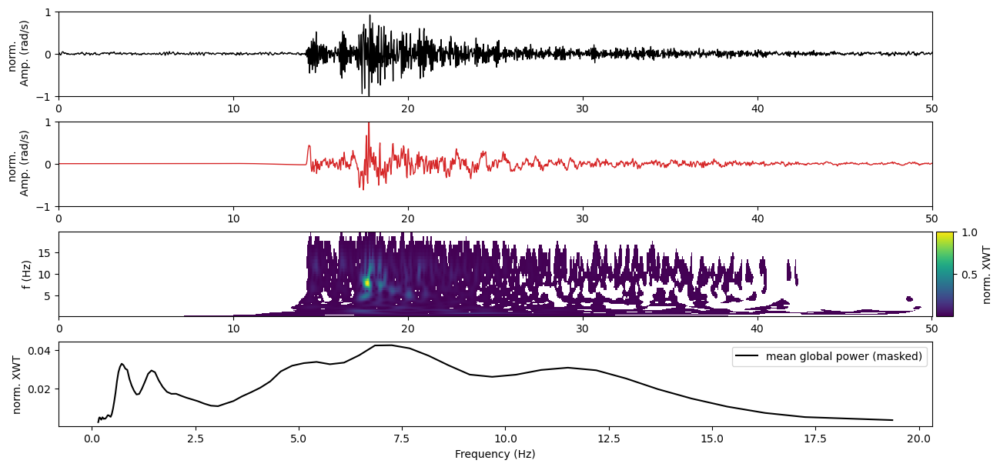


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221231_121226_xwt_Z.png ...

   -> Done



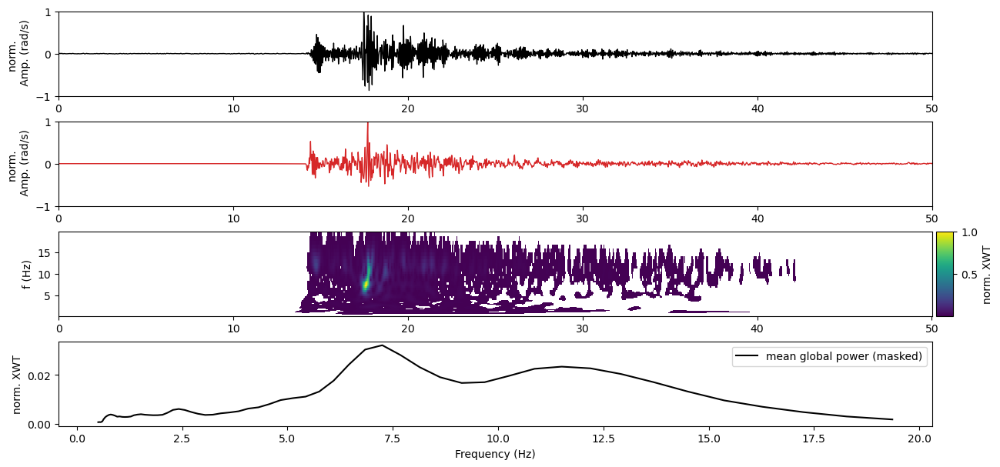


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221231_121226_xwt_N.png ...

   -> Done



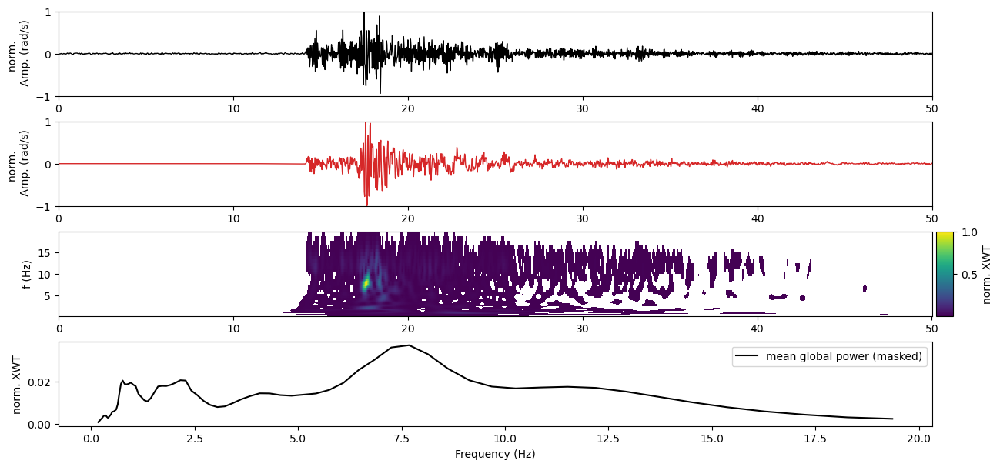


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221231_121226_xwt_E.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [03:57<00:00,  1.26it/s]


0.016207146117504553 0.0091897682358798


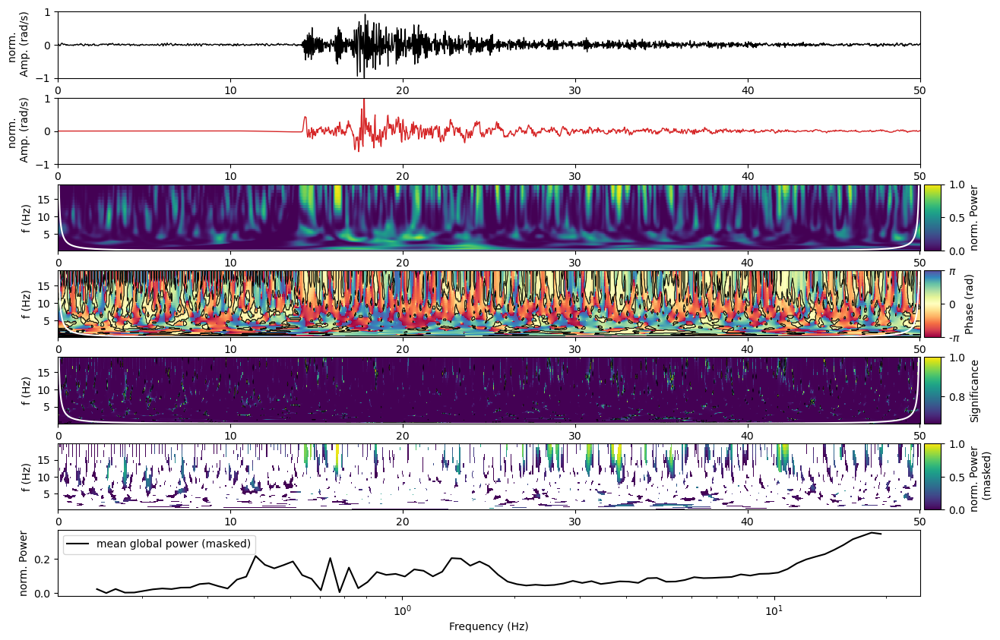


   -> saving /import/kilauea-data/BSPF/figures/wct/20221231_121226_wct_Z.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [04:02<00:00,  1.23it/s]


0.010975800048127642 0.005751431551319593


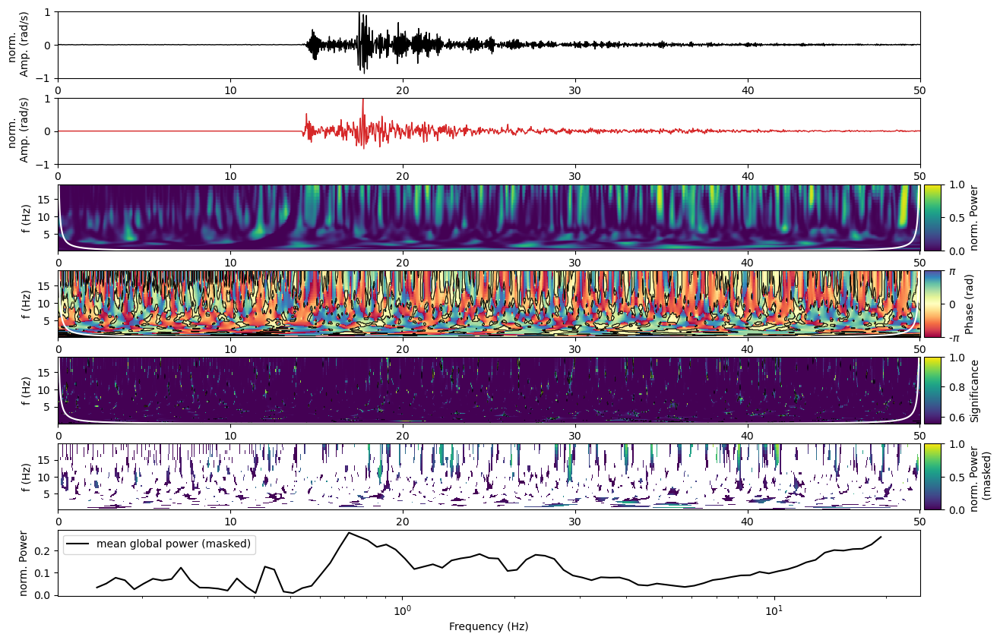


   -> saving /import/kilauea-data/BSPF/figures/wct/20221231_121226_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.011690608143012045 0.011236815752331288


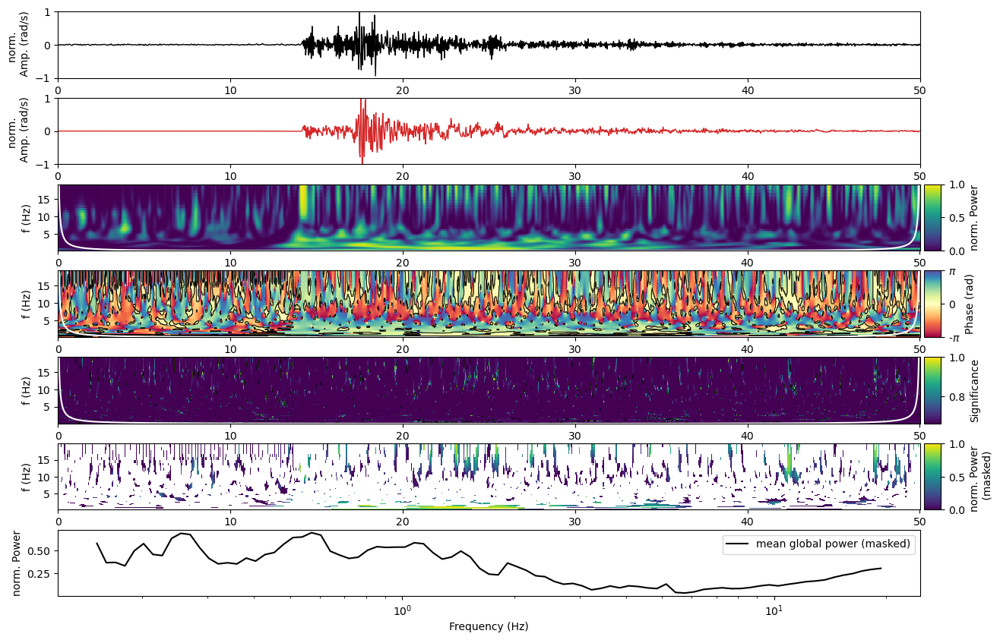


   -> saving /import/kilauea-data/BSPF/figures/wct/20221231_121226_wct_E.png ...

   -> Done



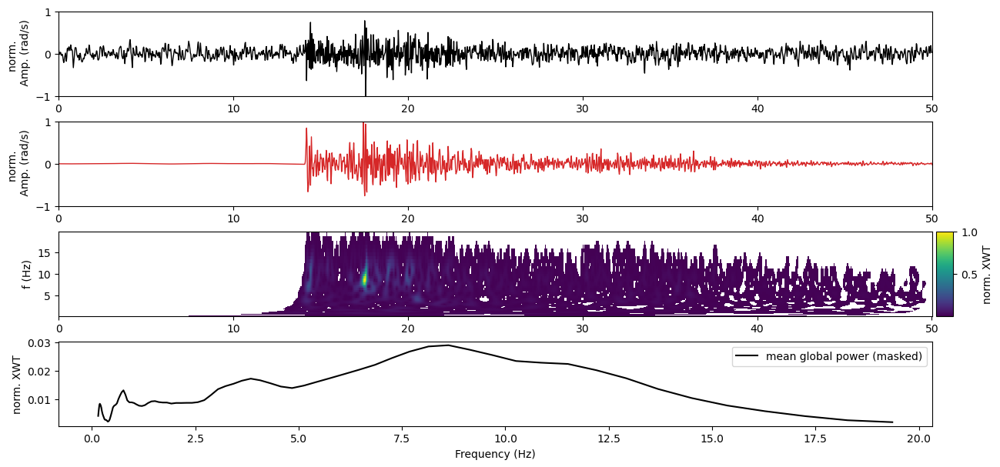


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230109_194256_xwt_Z.png ...

   -> Done



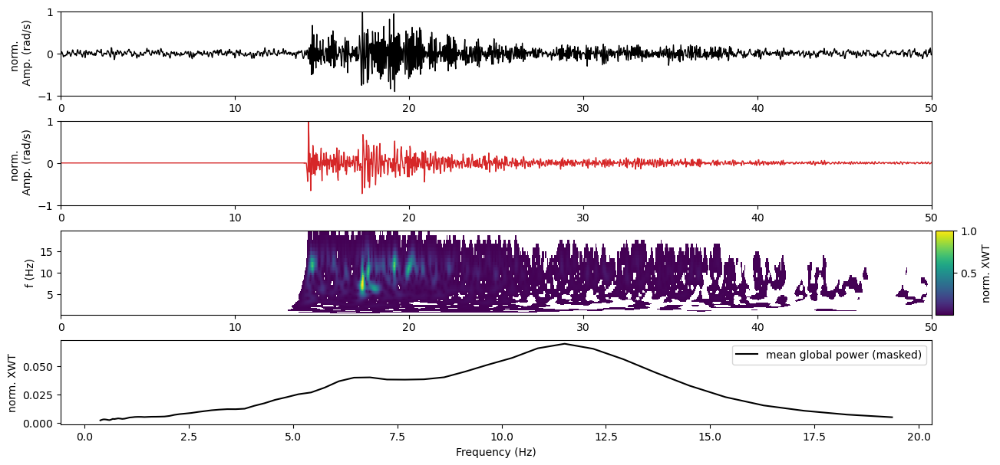


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230109_194256_xwt_N.png ...

   -> Done



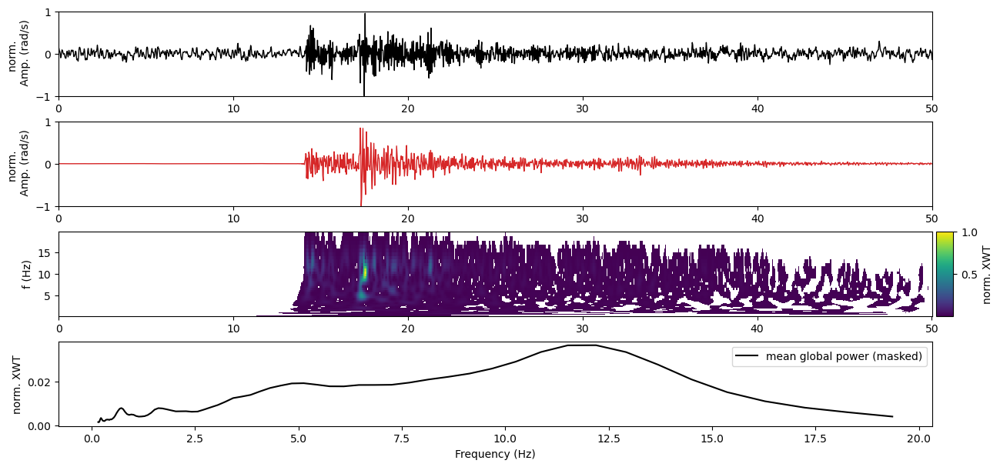


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230109_194256_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.02039968747867026 0.01592439776588954


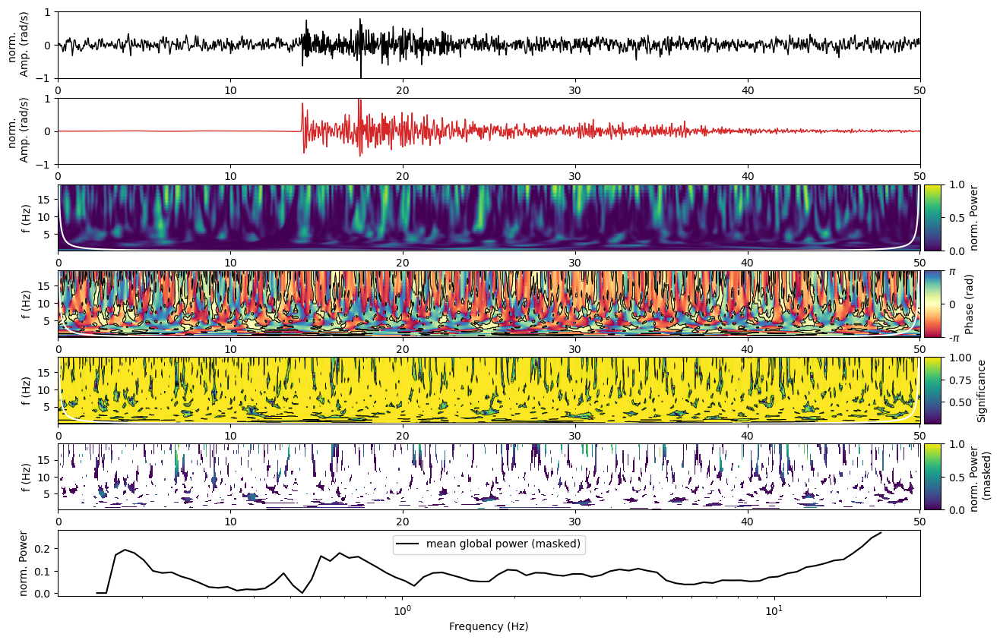


   -> saving /import/kilauea-data/BSPF/figures/wct/20230109_194256_wct_Z.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [04:02<00:00,  1.24it/s]


0.019564383072875512 0.008928406971289316


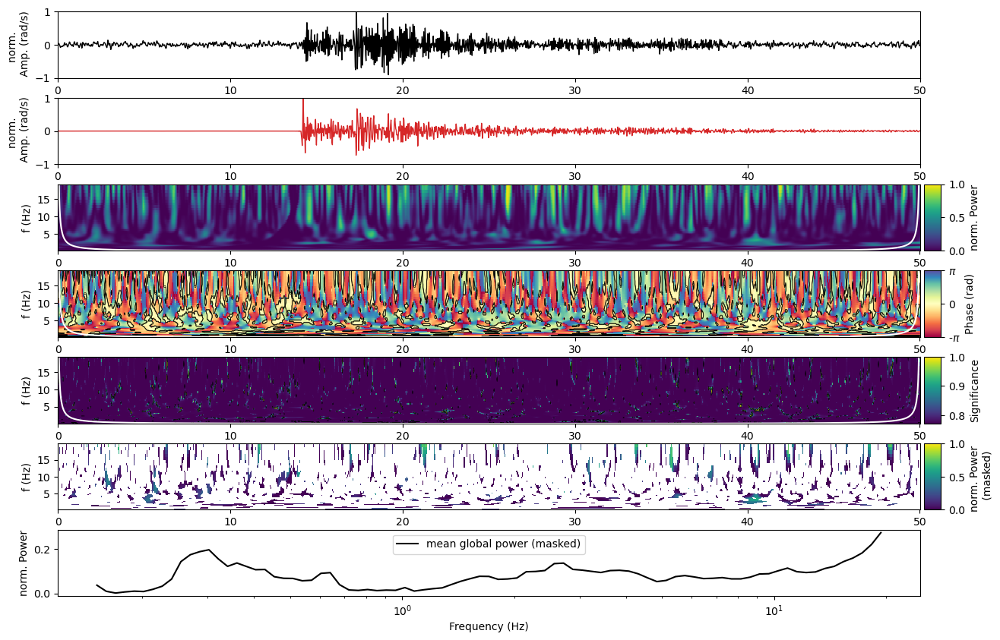


   -> saving /import/kilauea-data/BSPF/figures/wct/20230109_194256_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.015434782285932303 0.009096904724461721


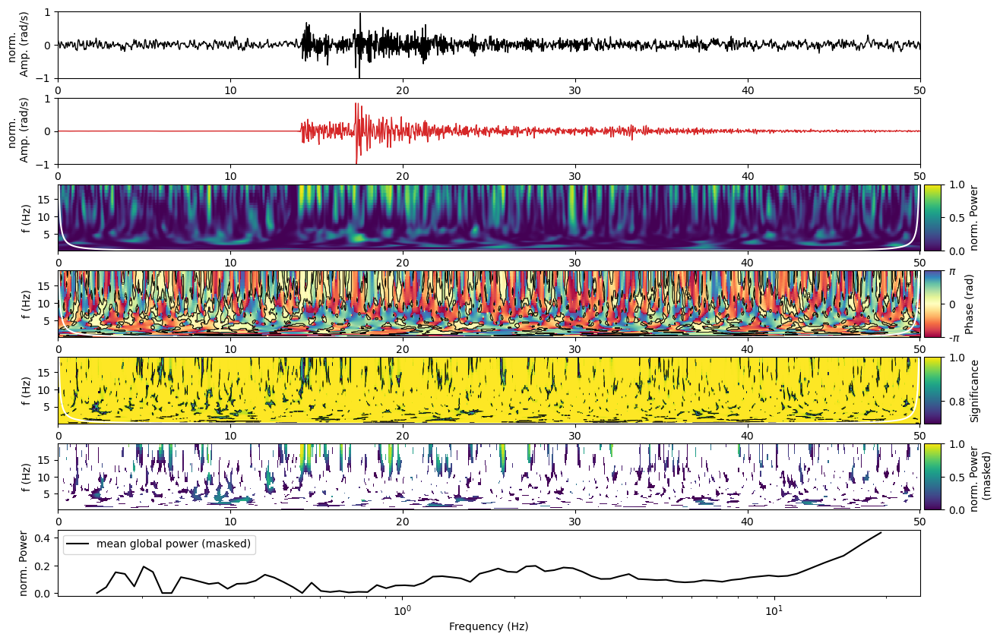


   -> saving /import/kilauea-data/BSPF/figures/wct/20230109_194256_wct_E.png ...

   -> Done



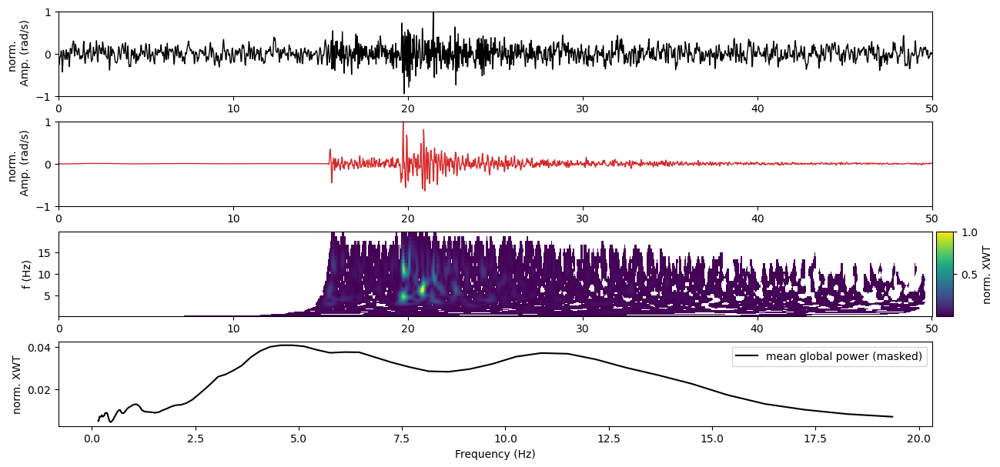


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230111_185920_xwt_Z.png ...

   -> Done



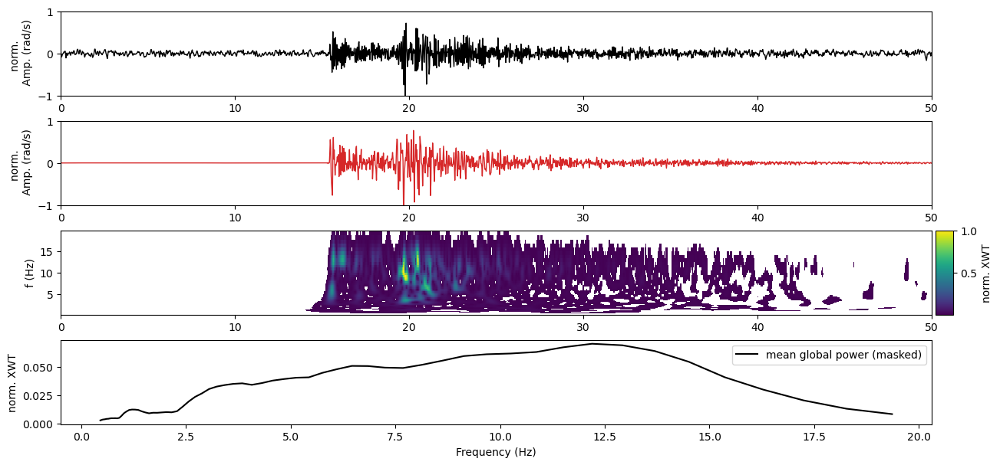


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230111_185920_xwt_N.png ...

   -> Done



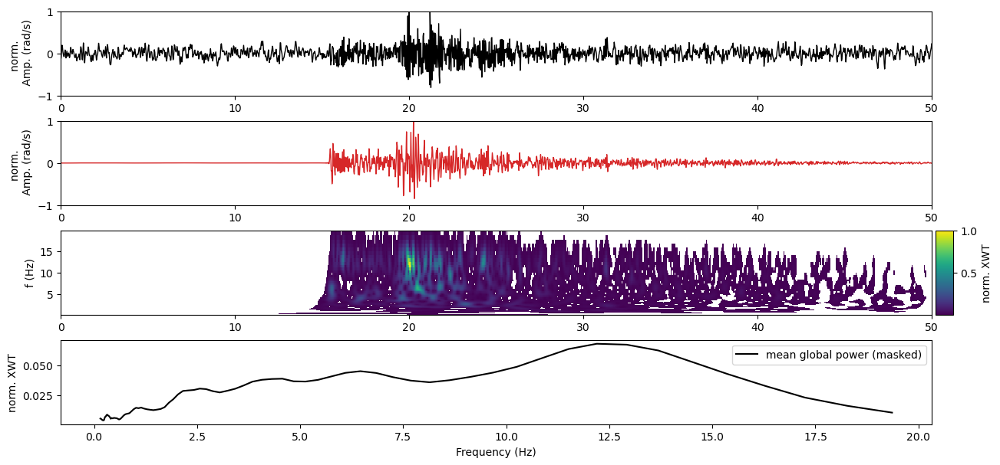


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230111_185920_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.027250503194723392 0.0067851310078046265


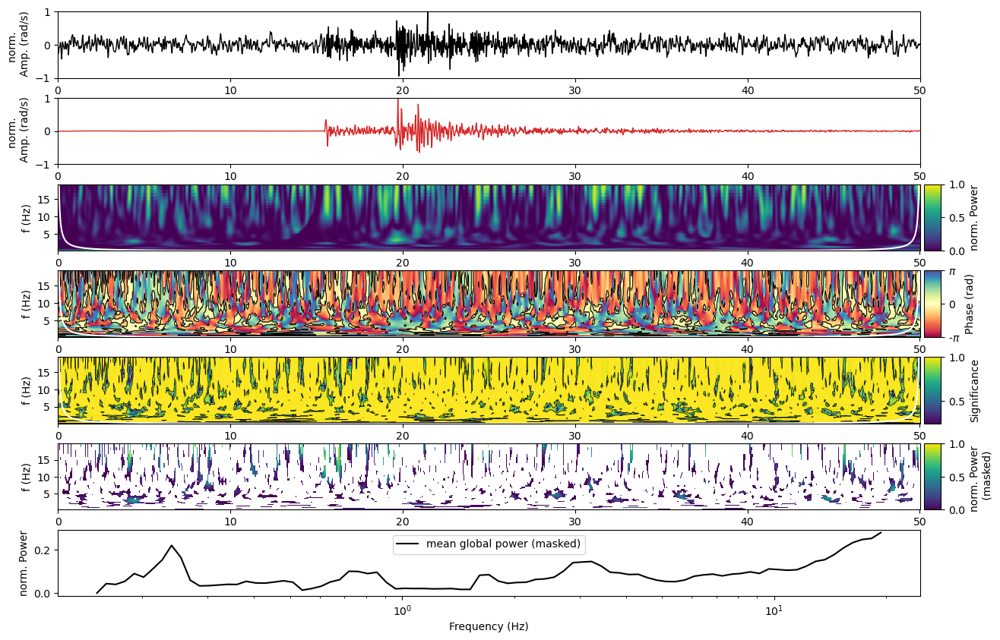


   -> saving /import/kilauea-data/BSPF/figures/wct/20230111_185920_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.010669935738600183 0.012332594981046843


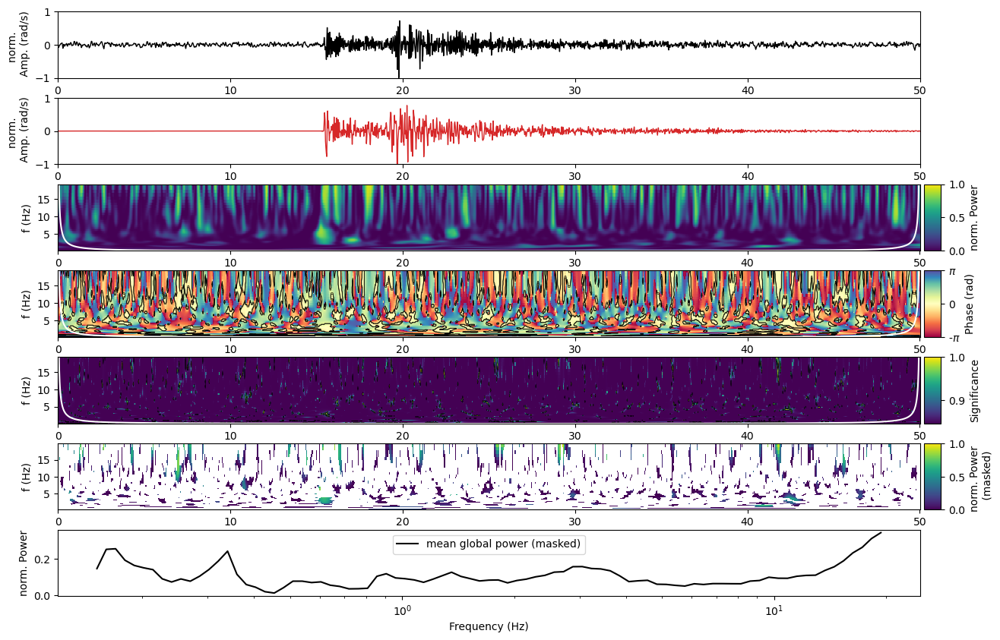


   -> saving /import/kilauea-data/BSPF/figures/wct/20230111_185920_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.02315222070959371 0.010994574467850274


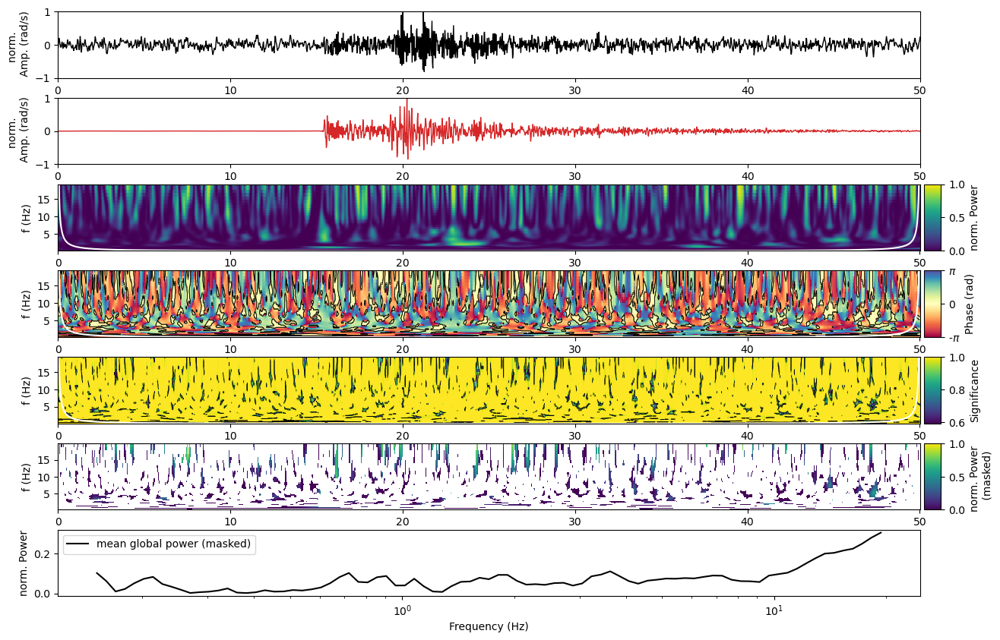


   -> saving /import/kilauea-data/BSPF/figures/wct/20230111_185920_wct_E.png ...

   -> Done



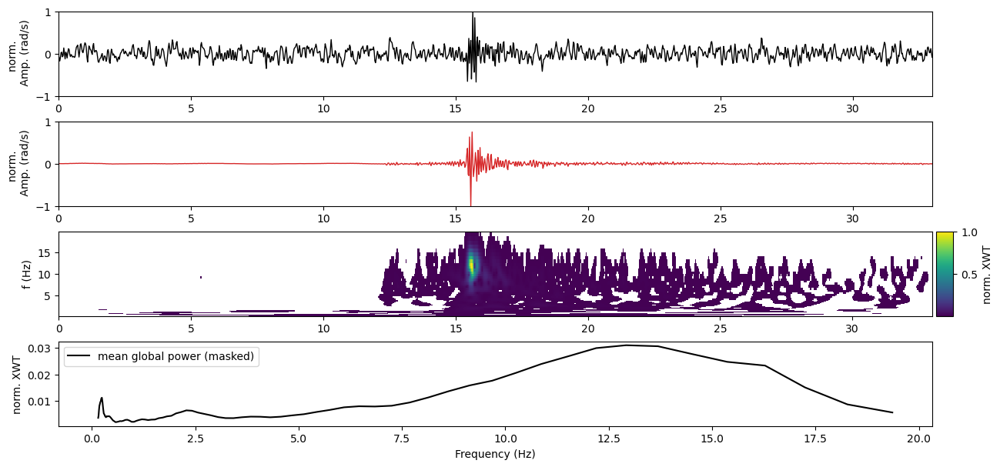


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230115_095854_xwt_Z.png ...

   -> Done



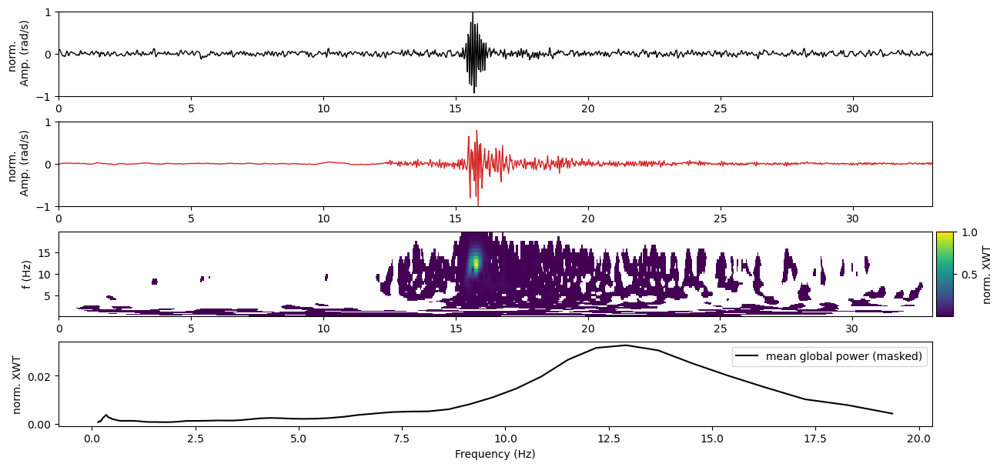


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230115_095854_xwt_N.png ...

   -> Done



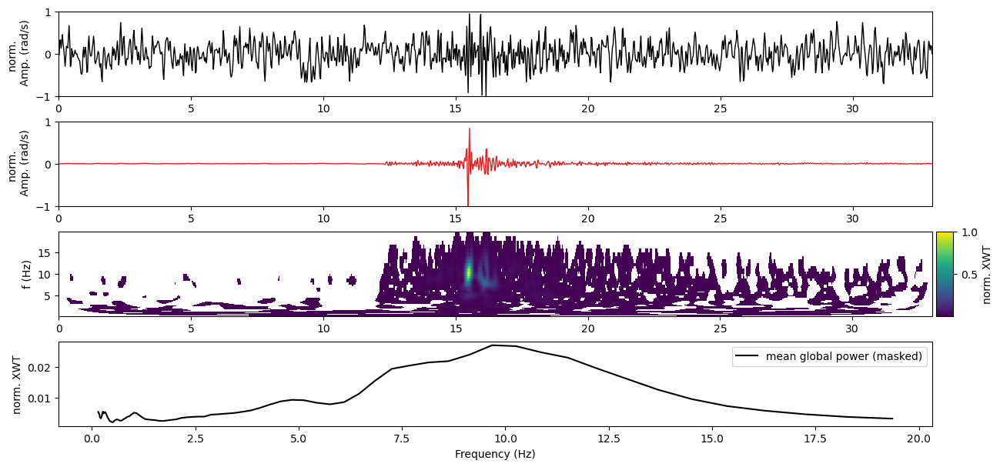


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230115_095854_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.018038445873897226 0.0029002409547812503


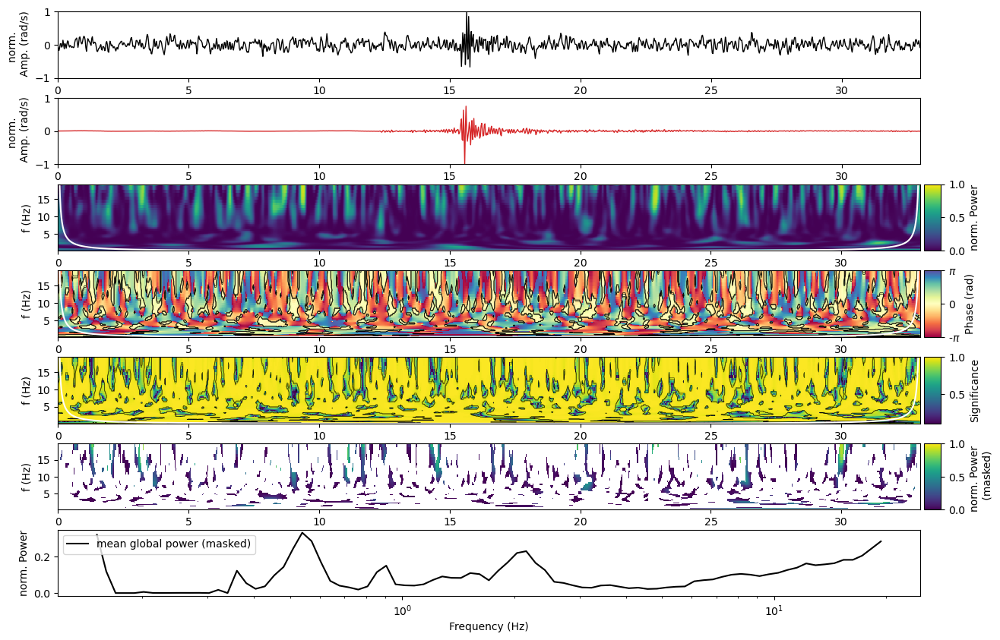


   -> saving /import/kilauea-data/BSPF/figures/wct/20230115_095854_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.007363831693891393 0.00649163065852081


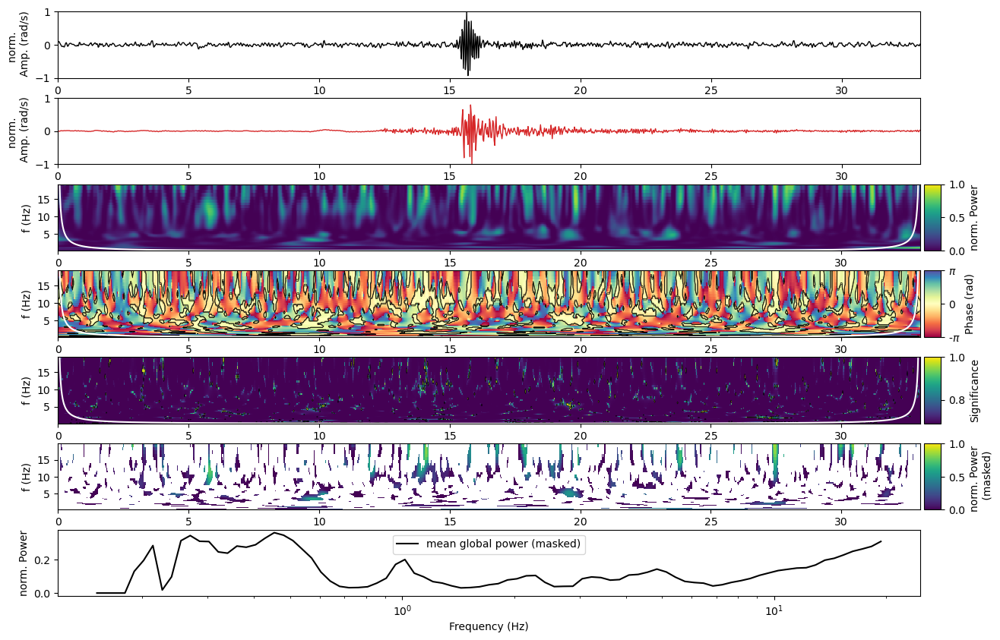


   -> saving /import/kilauea-data/BSPF/figures/wct/20230115_095854_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.07279748066398617 0.002681564548210121


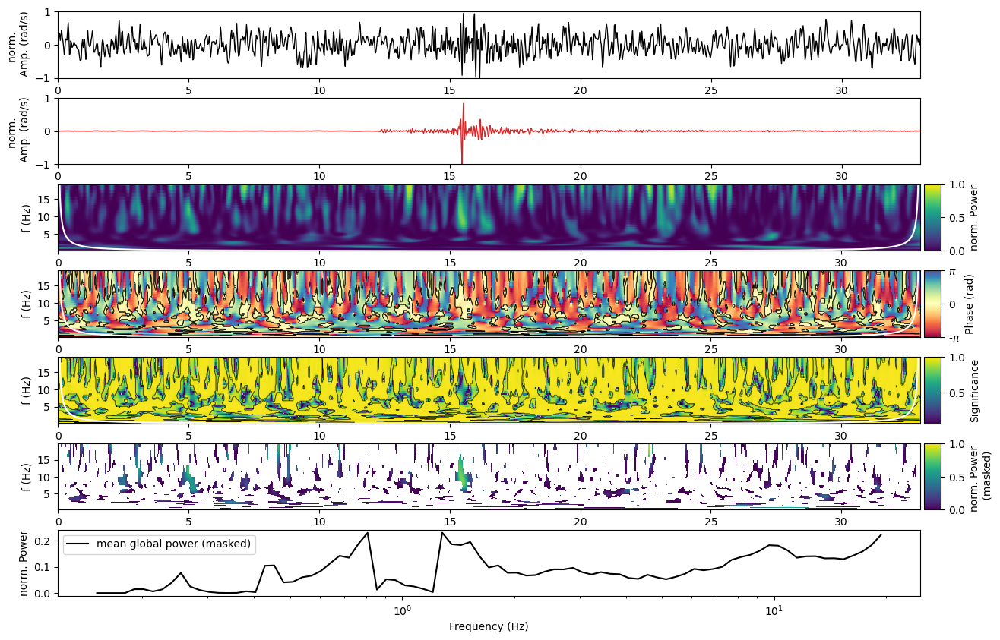


   -> saving /import/kilauea-data/BSPF/figures/wct/20230115_095854_wct_E.png ...

   -> Done



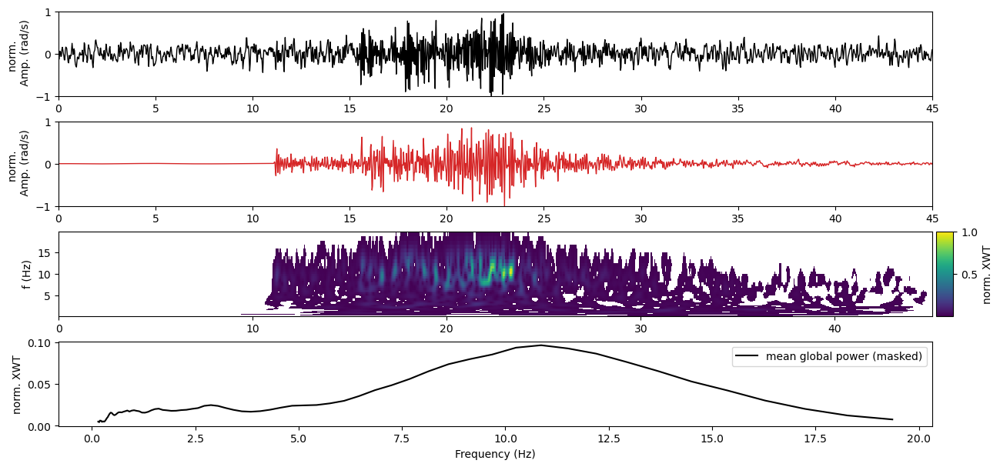


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230201_090502_xwt_Z.png ...

   -> Done



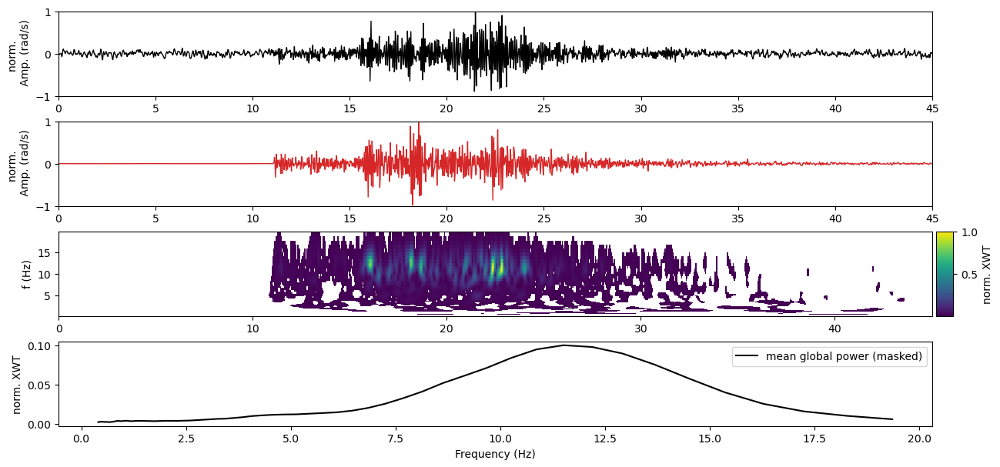


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230201_090502_xwt_N.png ...

   -> Done



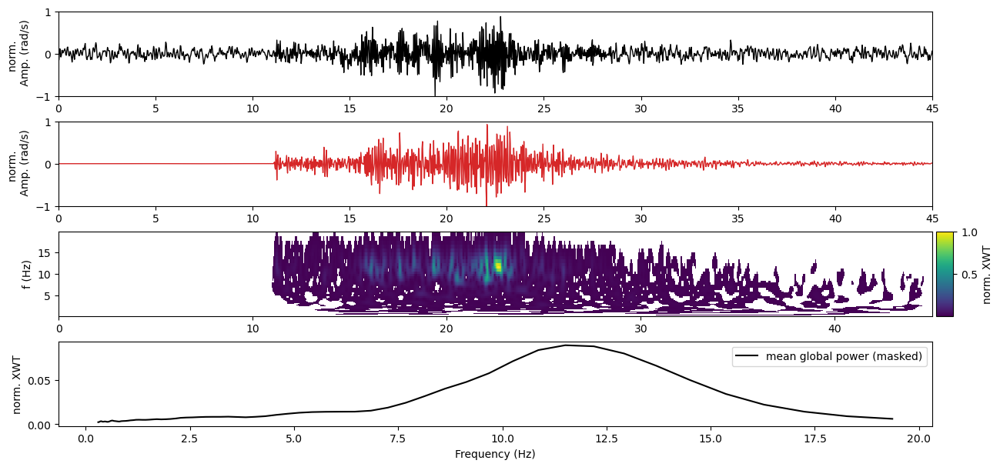


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230201_090502_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.042078156806300816 0.023680836677834428


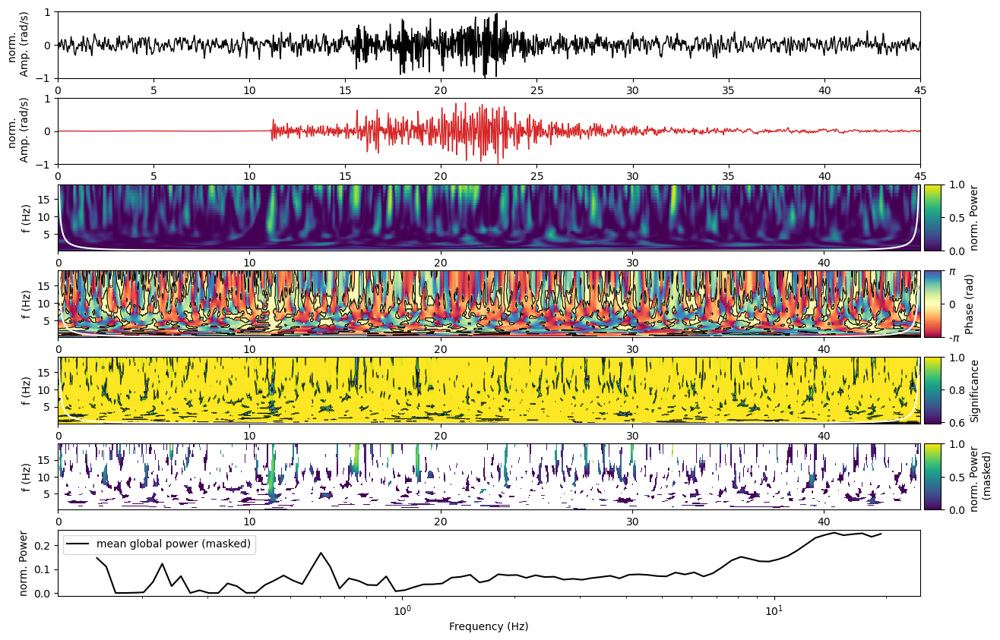


   -> saving /import/kilauea-data/BSPF/figures/wct/20230201_090502_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.023703790125692625 0.01880318137105036


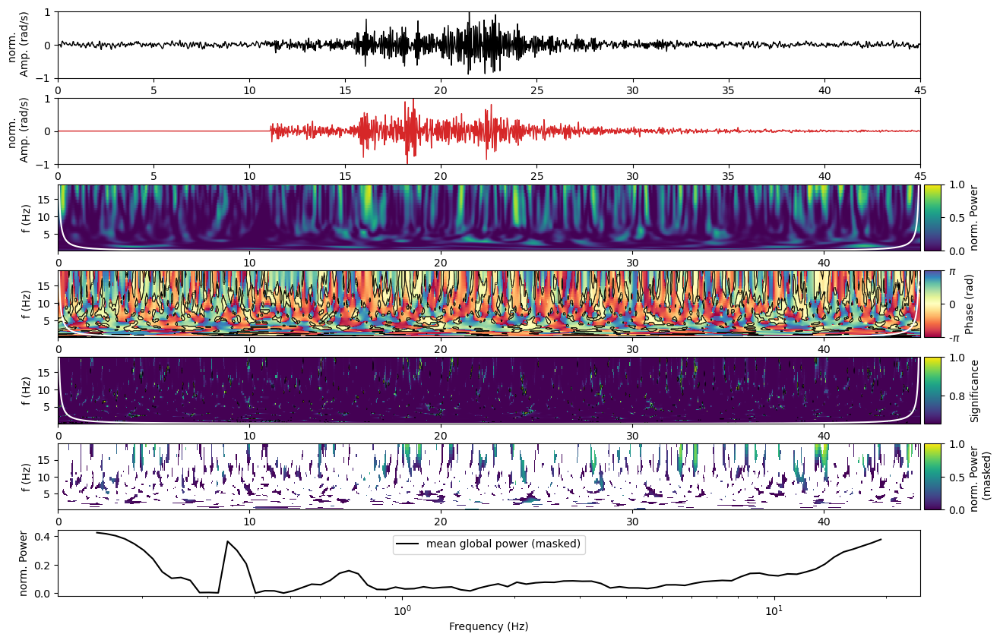


   -> saving /import/kilauea-data/BSPF/figures/wct/20230201_090502_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.027421344382548316 0.02617248713506003


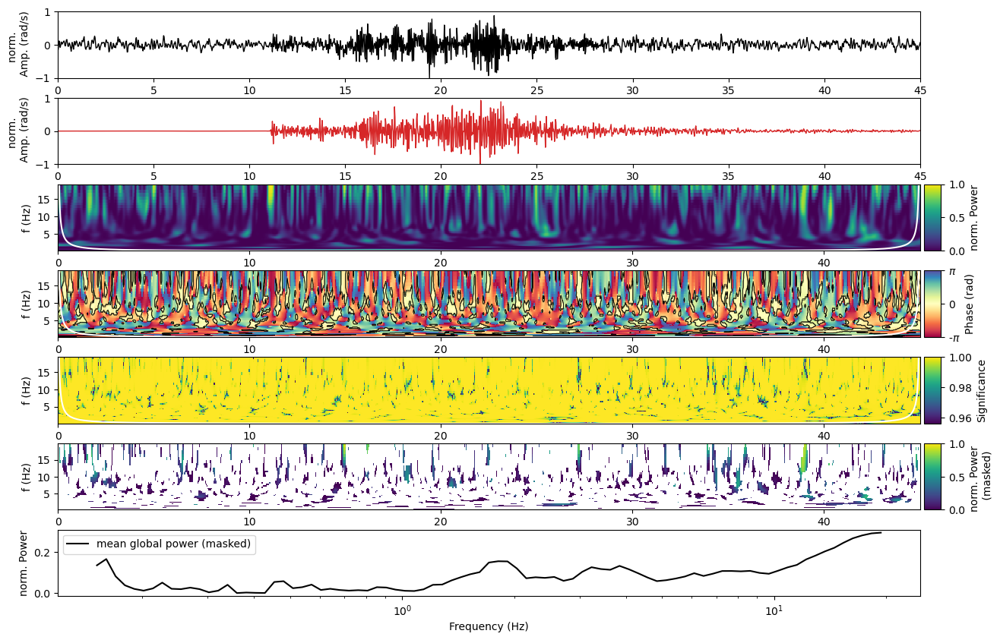


   -> saving /import/kilauea-data/BSPF/figures/wct/20230201_090502_wct_E.png ...

   -> Done



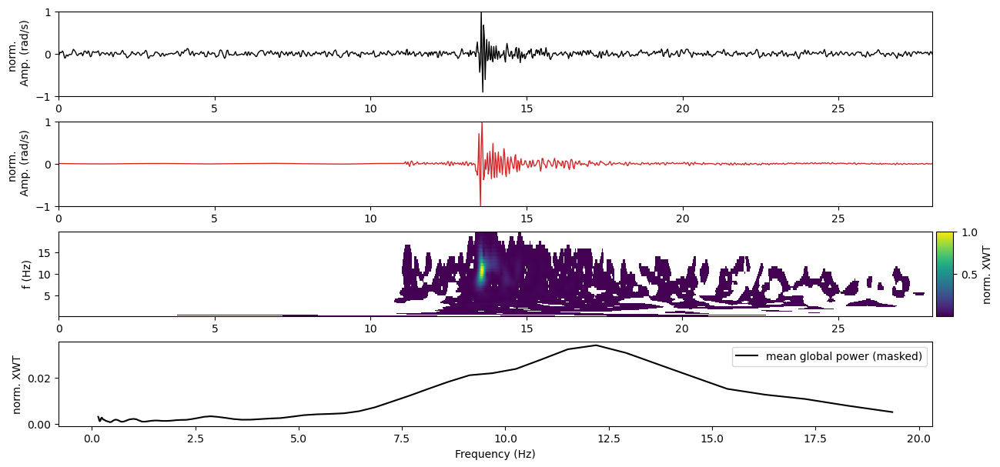


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230301_224903_xwt_Z.png ...

   -> Done



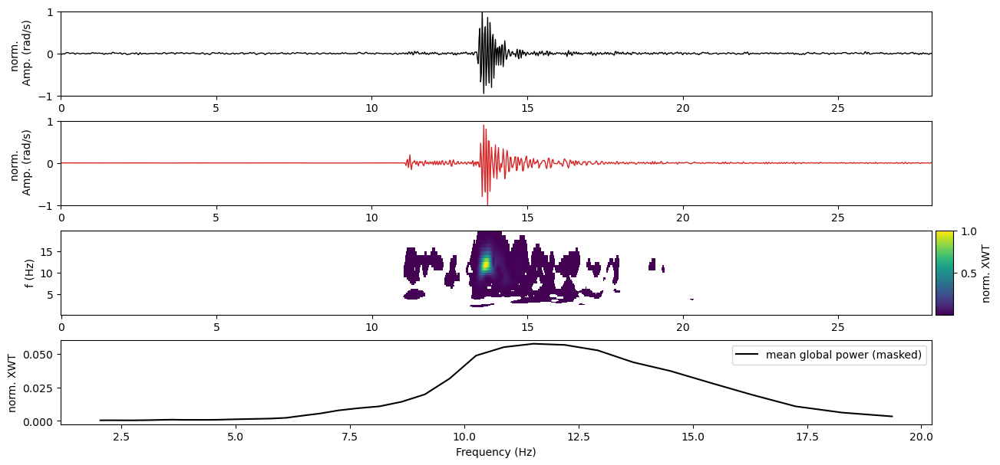


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230301_224903_xwt_N.png ...

   -> Done



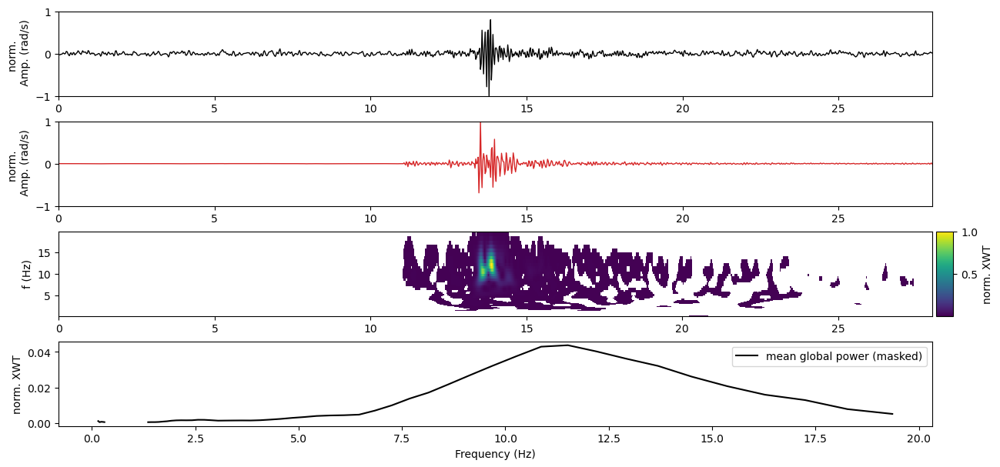


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230301_224903_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.0052615058670634 0.004813175682410344


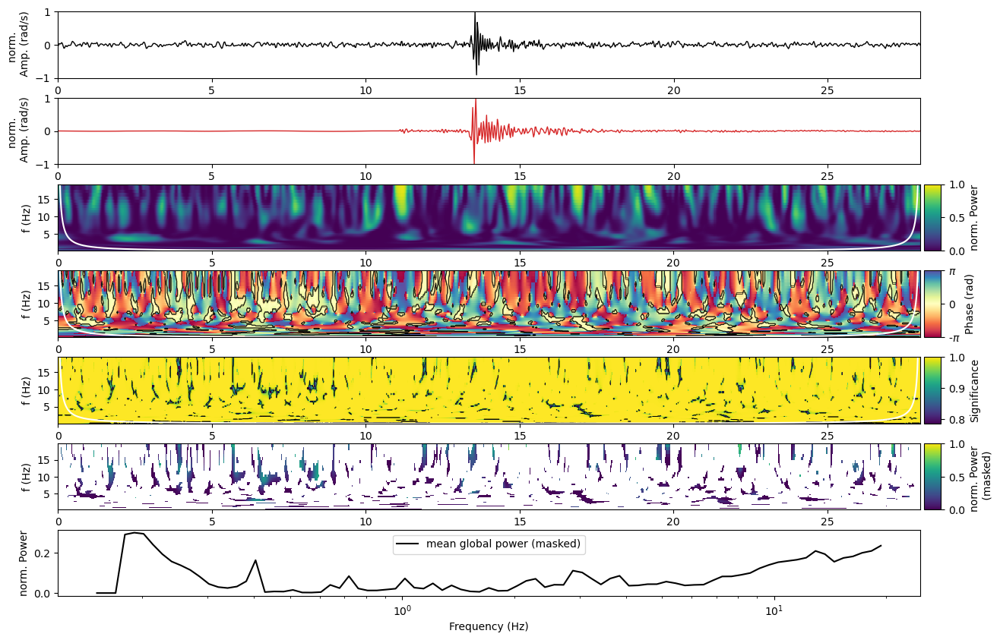


   -> saving /import/kilauea-data/BSPF/figures/wct/20230301_224903_wct_Z.png ...

   -> Done

Calculating wavelet coherence significance


100%|███████████████████████████████████████████████████| 300/300 [04:02<00:00,  1.23it/s]


0.007712749821847448 0.006388294660827189


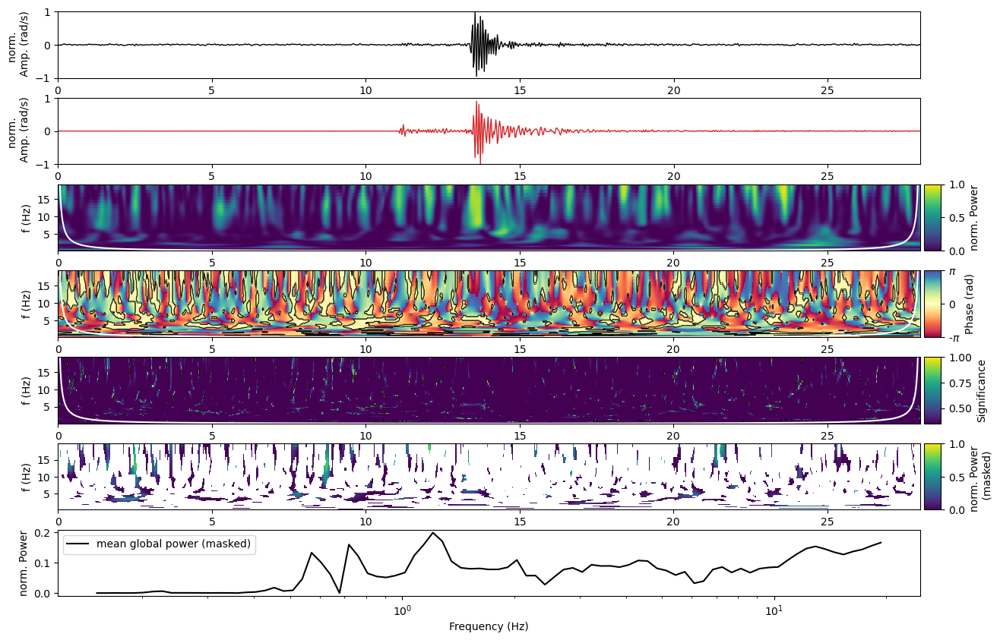


   -> saving /import/kilauea-data/BSPF/figures/wct/20230301_224903_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.005831222588842714 0.003869957033553927


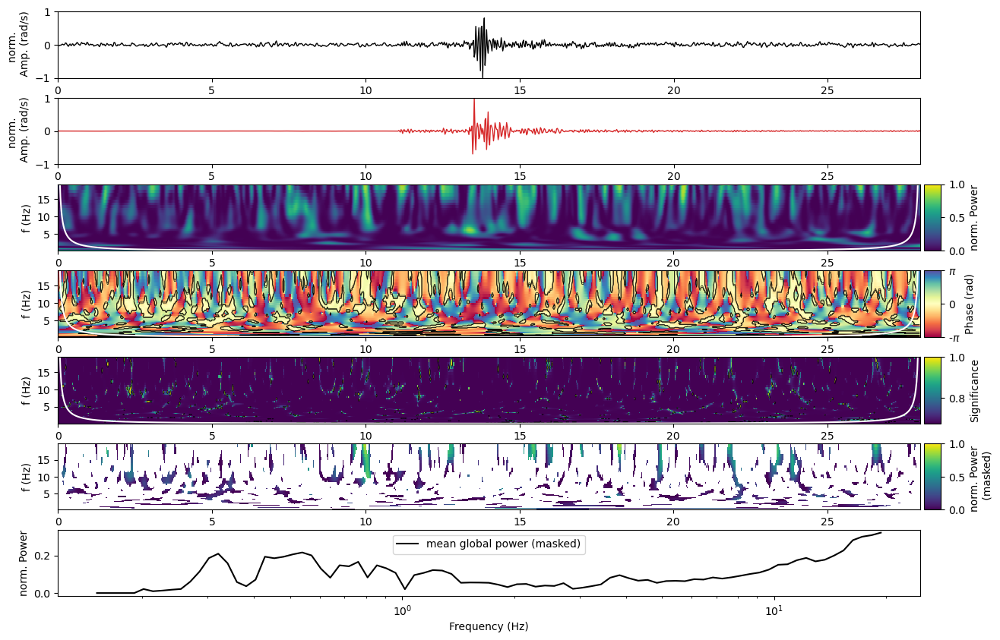


   -> saving /import/kilauea-data/BSPF/figures/wct/20230301_224903_wct_E.png ...

   -> Done



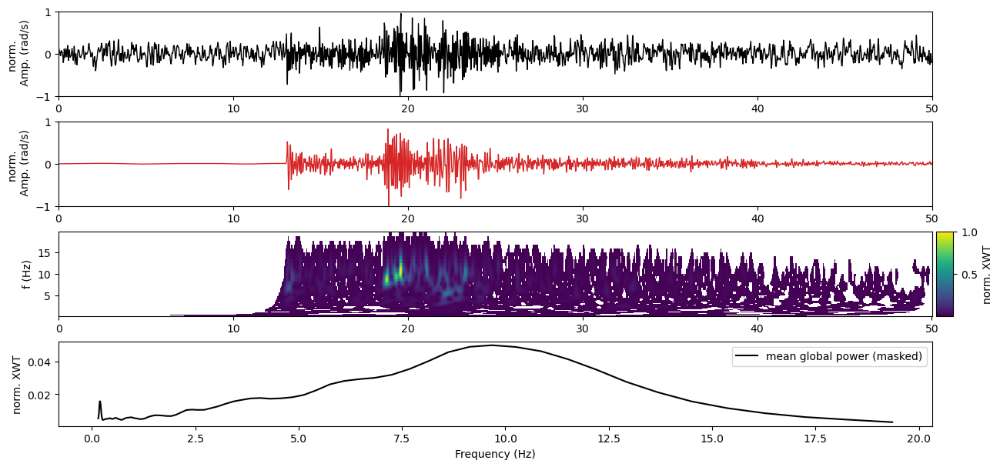


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230324_134513_xwt_Z.png ...

   -> Done



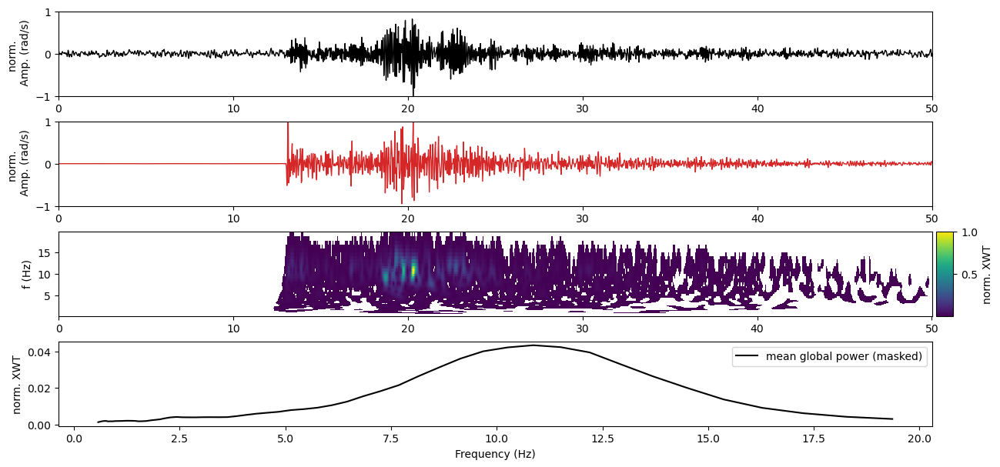


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230324_134513_xwt_N.png ...

   -> Done



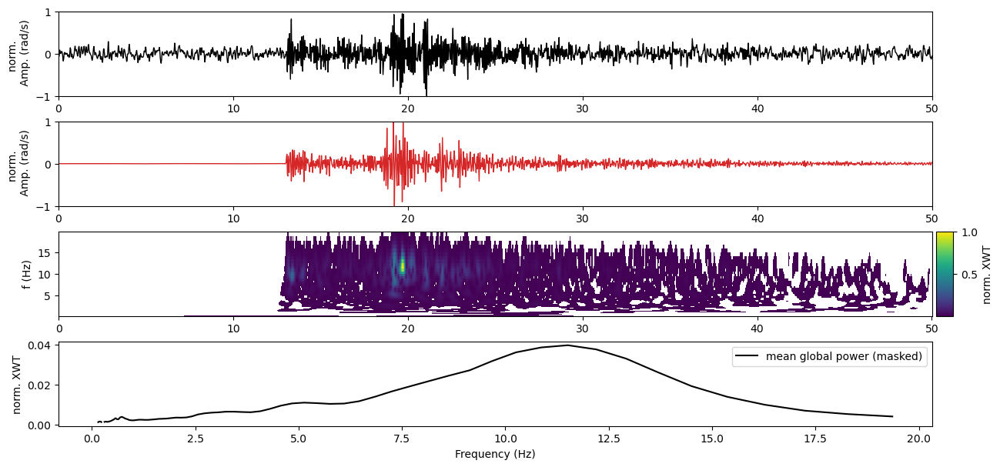


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230324_134513_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.036817969885739724 0.016488291805507697


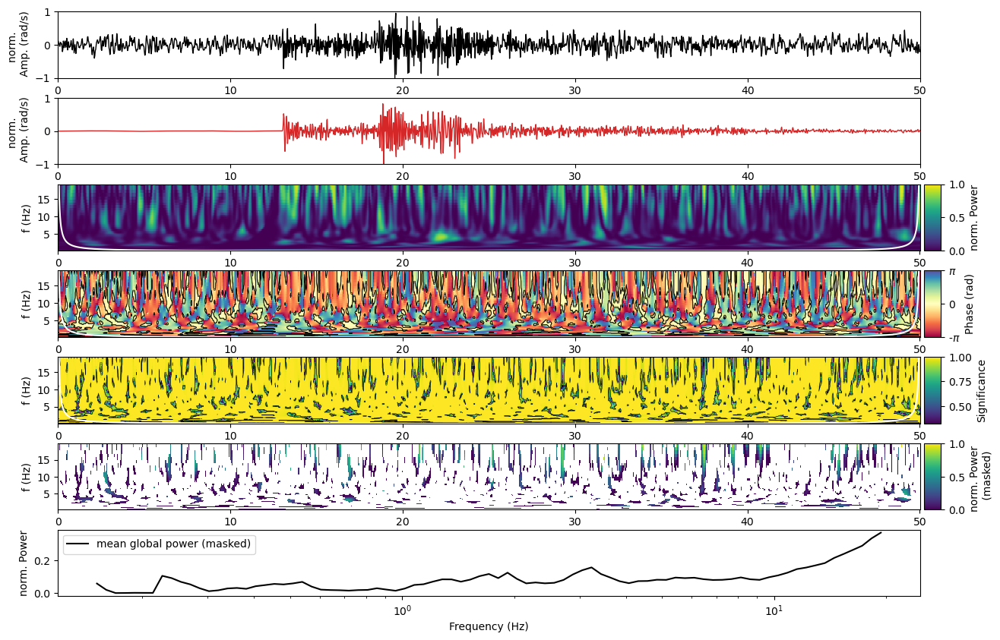


   -> saving /import/kilauea-data/BSPF/figures/wct/20230324_134513_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.017572741225510575 0.01899535520342559


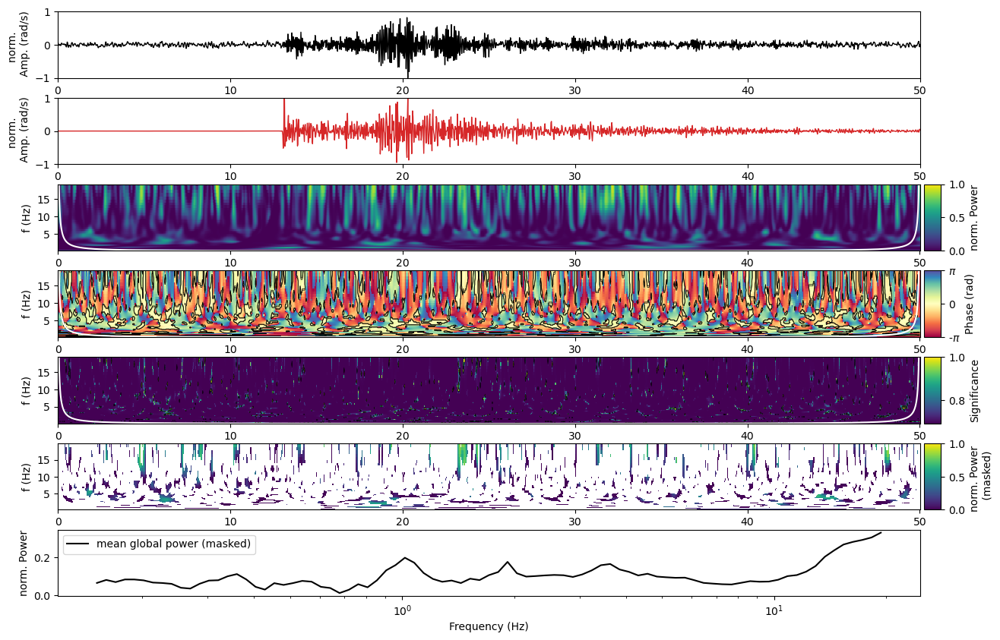


   -> saving /import/kilauea-data/BSPF/figures/wct/20230324_134513_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.025770322342961106 0.011710823990369778


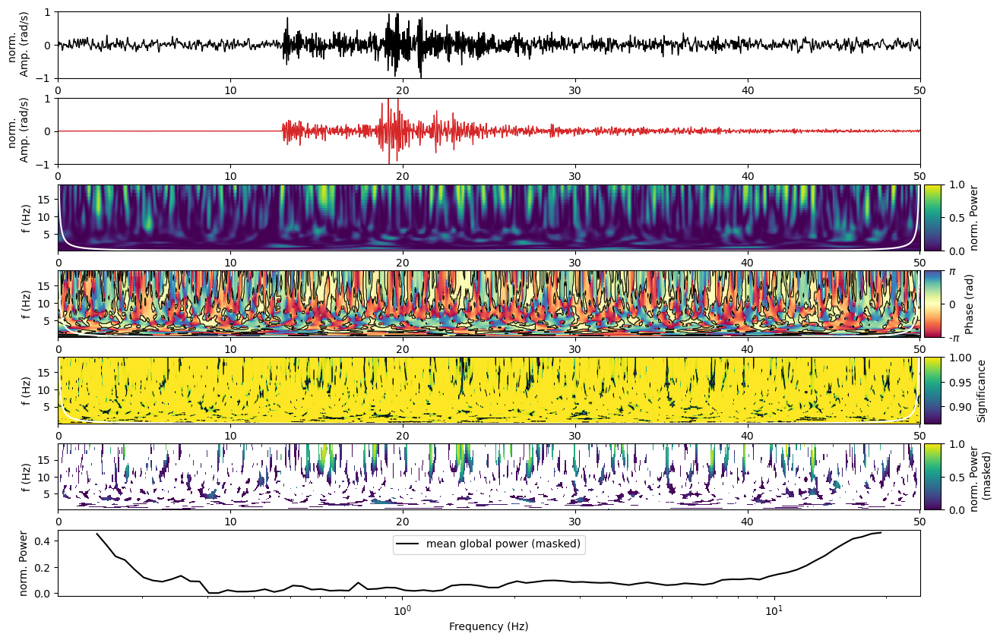


   -> saving /import/kilauea-data/BSPF/figures/wct/20230324_134513_wct_E.png ...

   -> Done



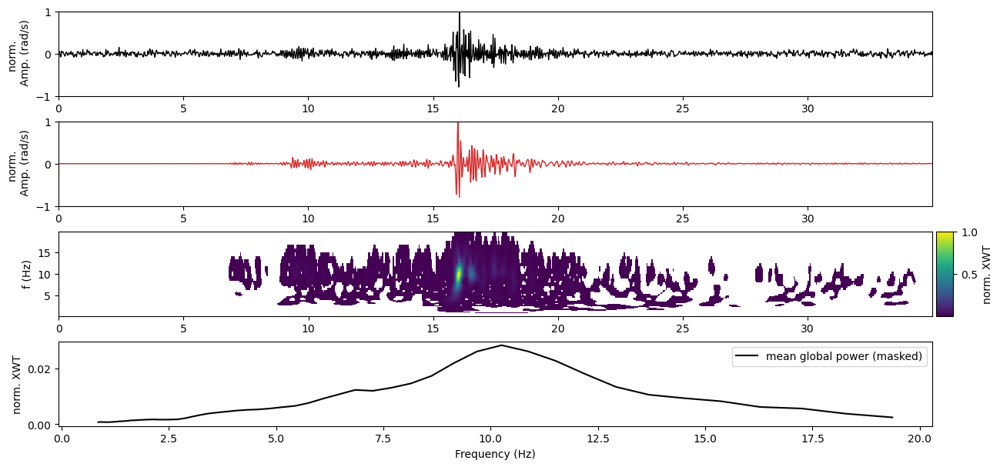


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230410_145100_xwt_Z.png ...

   -> Done



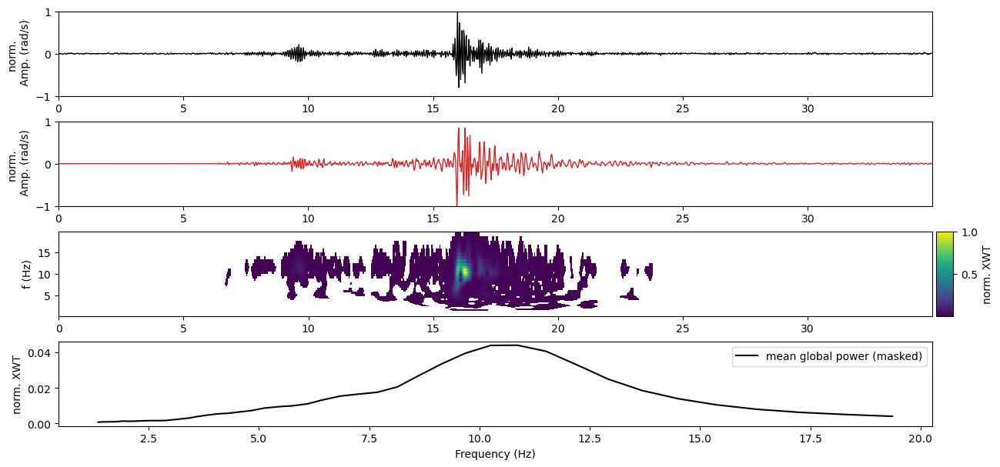


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230410_145100_xwt_N.png ...

   -> Done



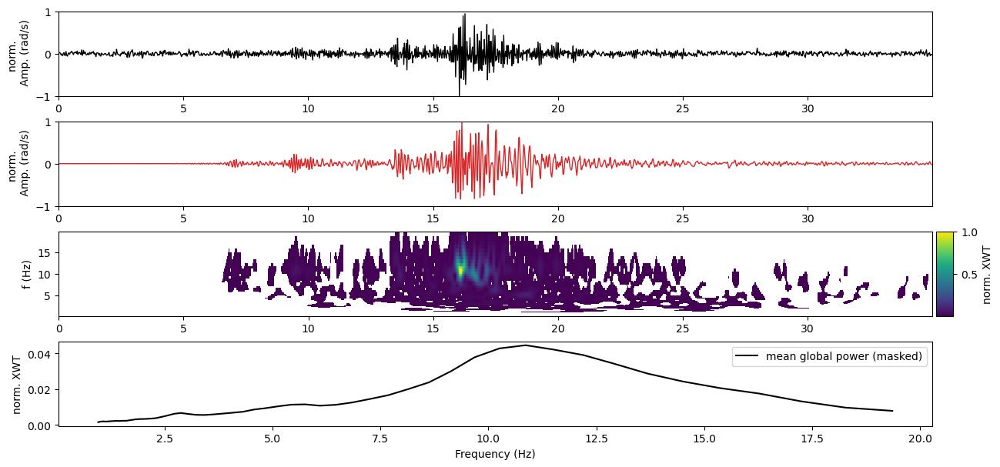


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230410_145100_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.007731217577027337 0.005253815532972535


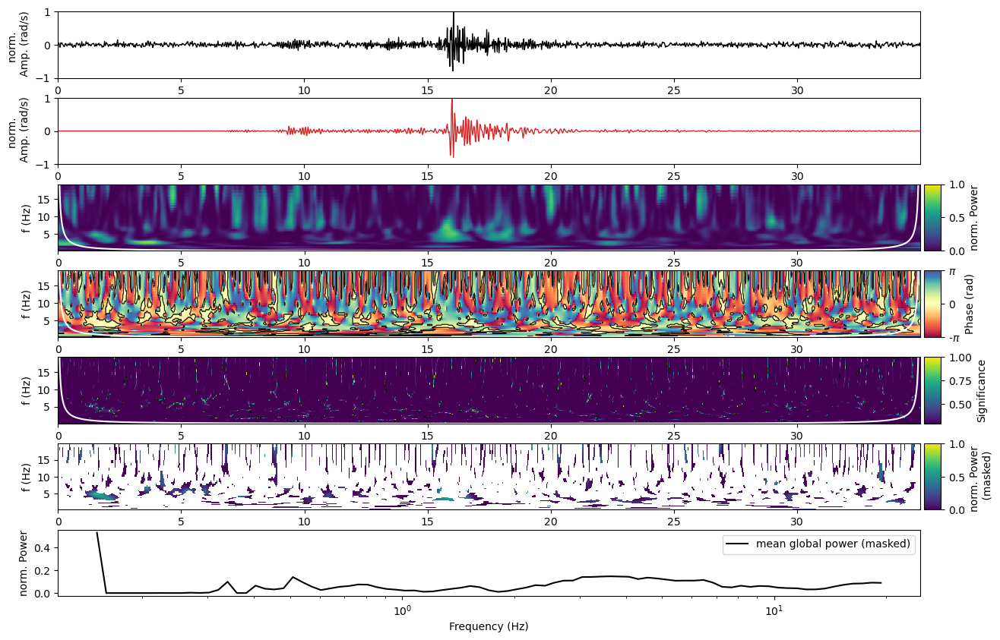


   -> saving /import/kilauea-data/BSPF/figures/wct/20230410_145100_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.00549787376226623 0.008388168229946171


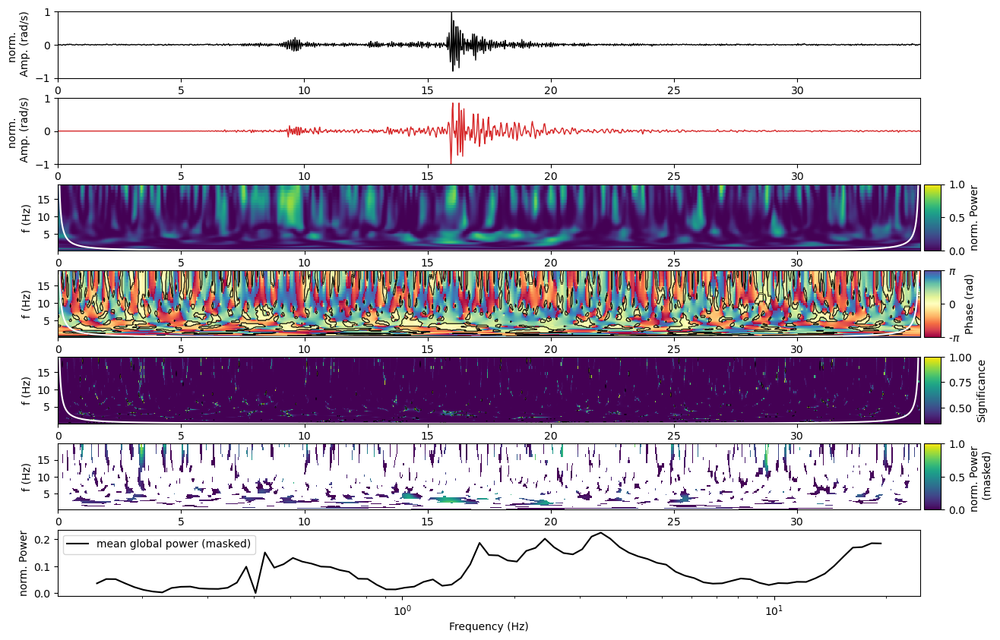


   -> saving /import/kilauea-data/BSPF/figures/wct/20230410_145100_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.01188764651027351 0.01972244574185103


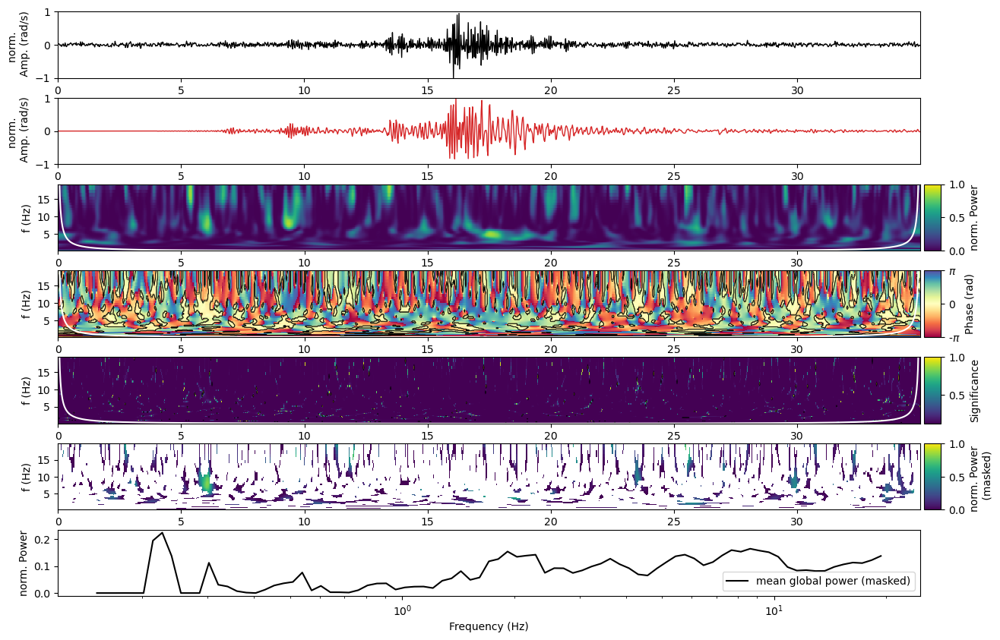


   -> saving /import/kilauea-data/BSPF/figures/wct/20230410_145100_wct_E.png ...

   -> Done



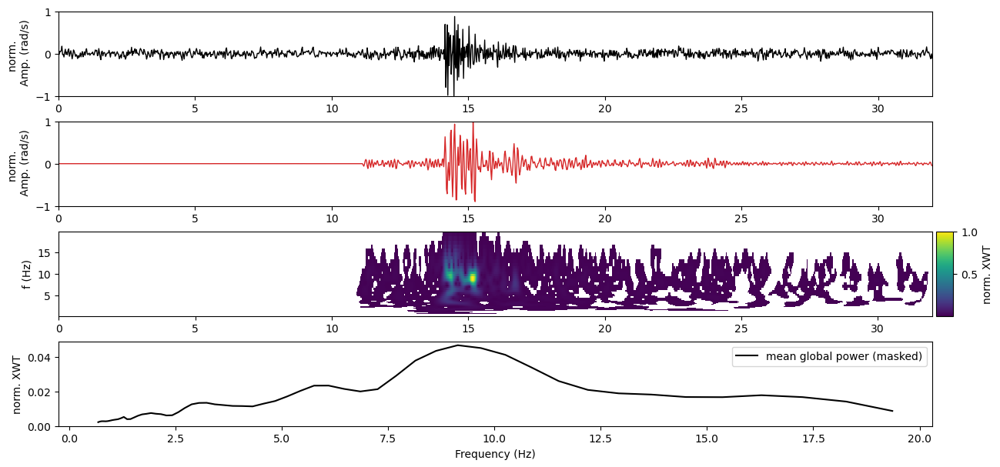


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230417_185236_xwt_Z.png ...

   -> Done



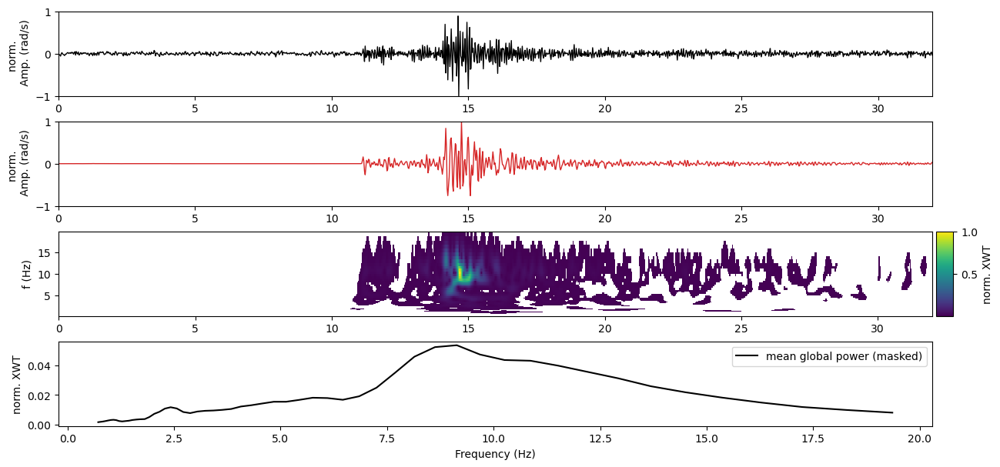


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230417_185236_xwt_N.png ...

   -> Done



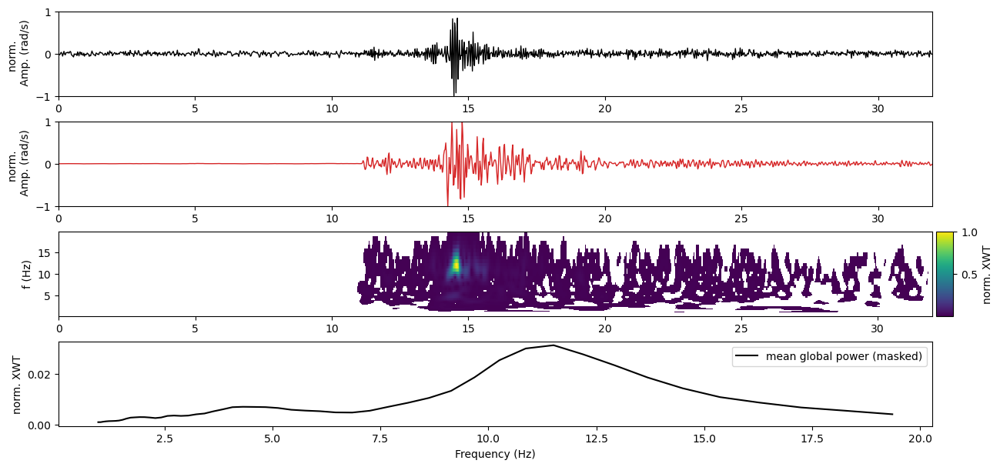


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230417_185236_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.01194874882858578 0.013553598766841419


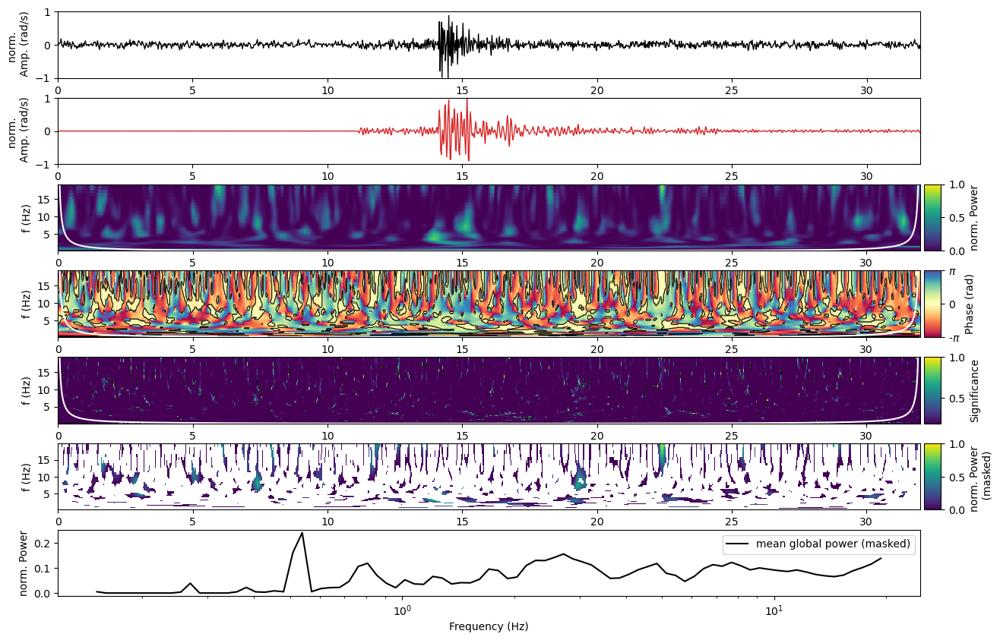


   -> saving /import/kilauea-data/BSPF/figures/wct/20230417_185236_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.010451047275246142 0.010172737444479236


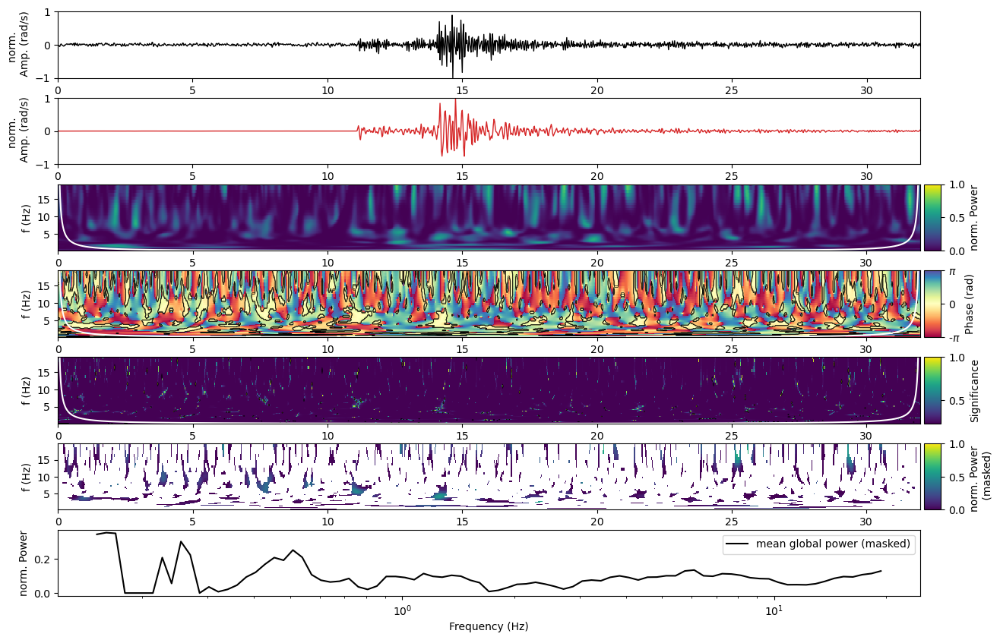


   -> saving /import/kilauea-data/BSPF/figures/wct/20230417_185236_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.007984976301343991 0.013853175797161369


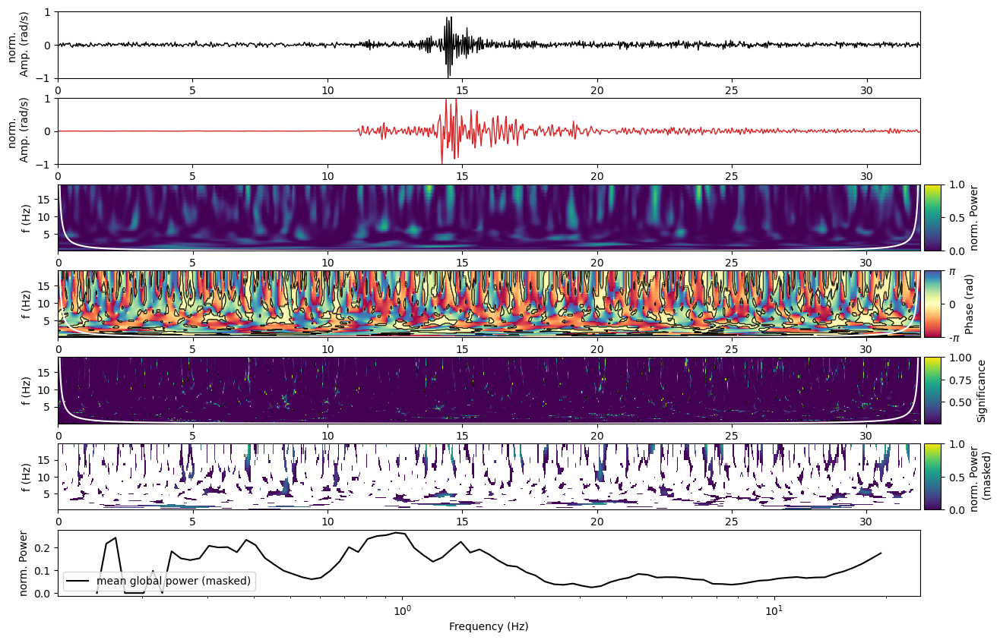


   -> saving /import/kilauea-data/BSPF/figures/wct/20230417_185236_wct_E.png ...

   -> Done



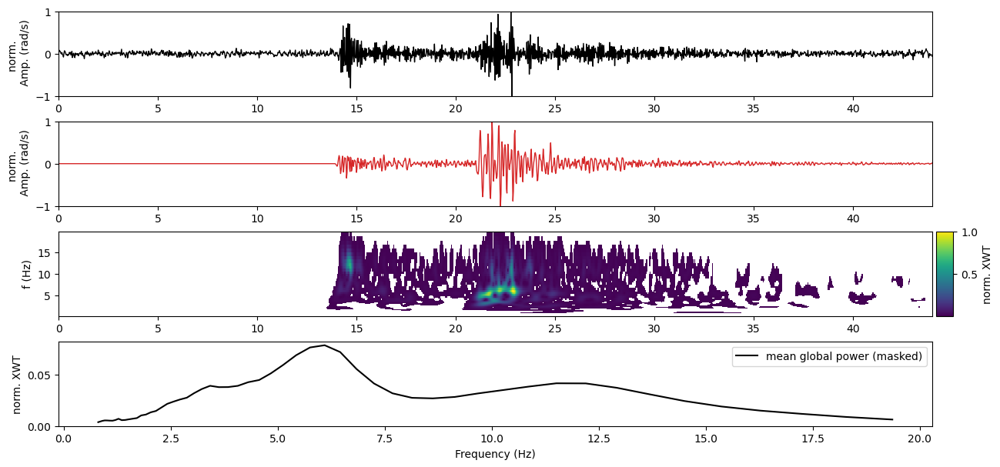


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230426_064658_xwt_Z.png ...

   -> Done



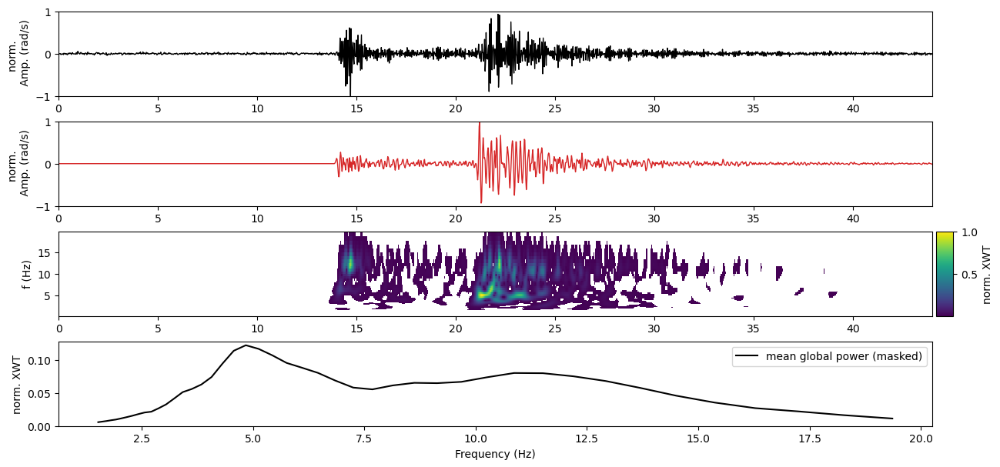


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230426_064658_xwt_N.png ...

   -> Done



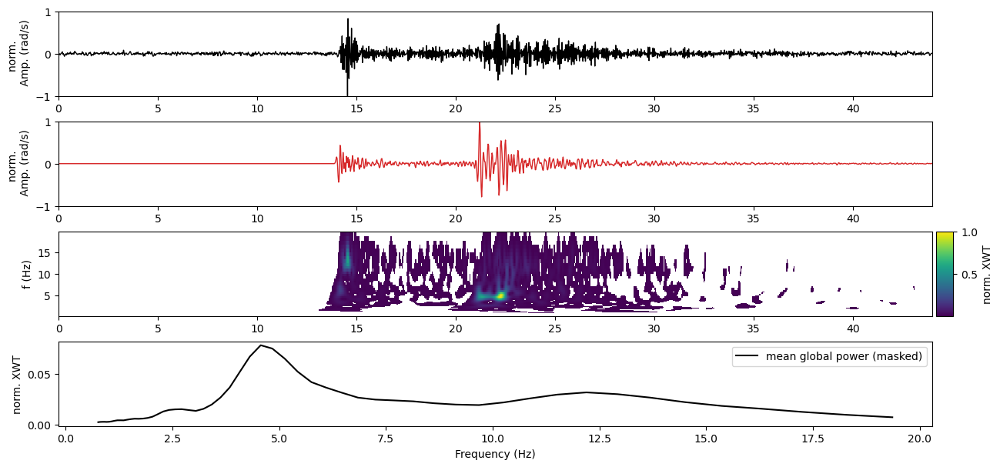


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230426_064658_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.014032023807670347 0.013088617336525261


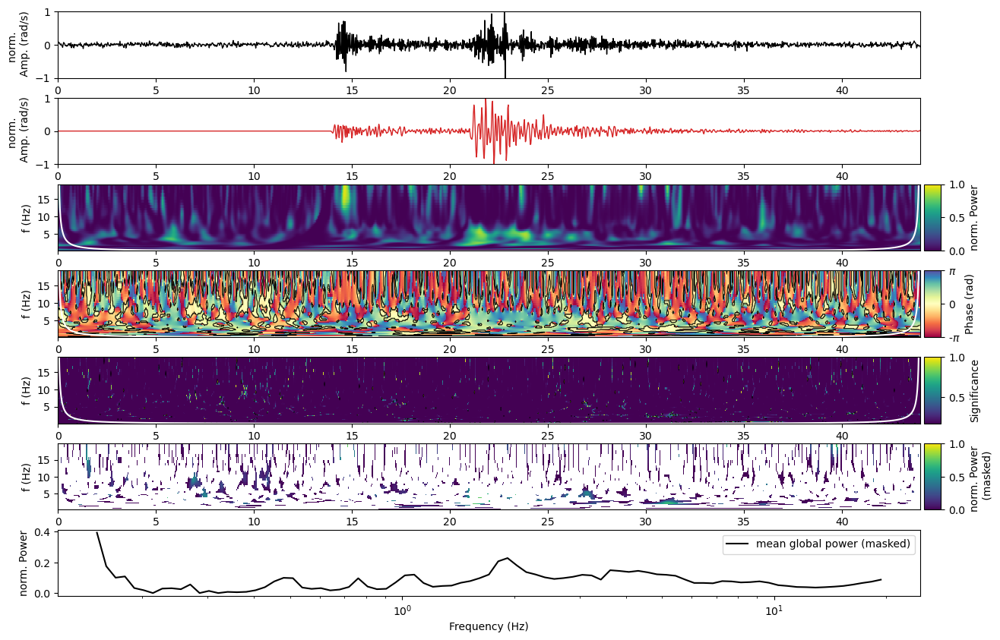


   -> saving /import/kilauea-data/BSPF/figures/wct/20230426_064658_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.013288636968501006 0.012332854904093438


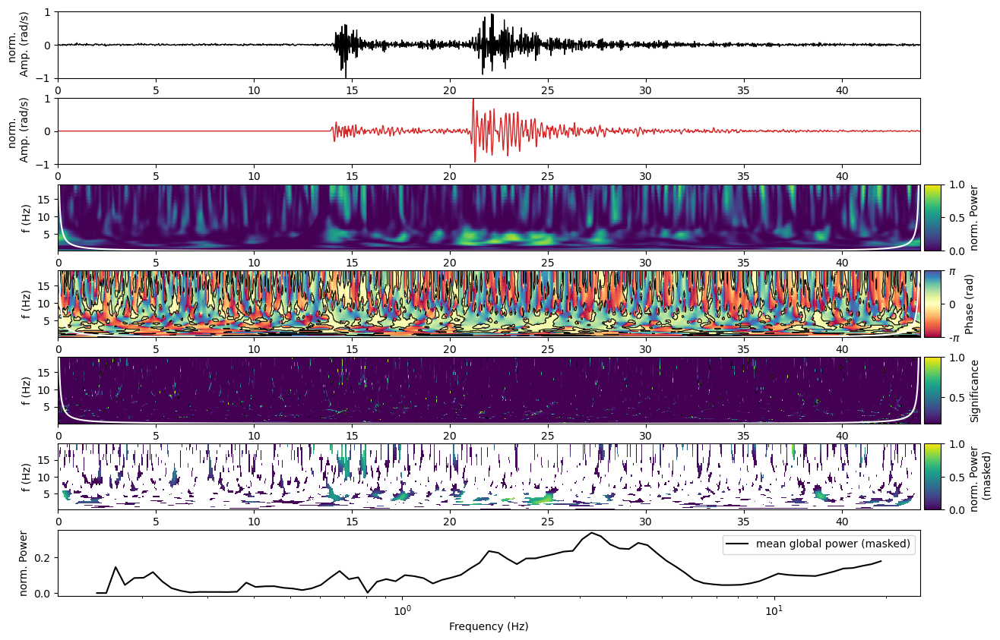


   -> saving /import/kilauea-data/BSPF/figures/wct/20230426_064658_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.010253301818265672 0.0071958391911113


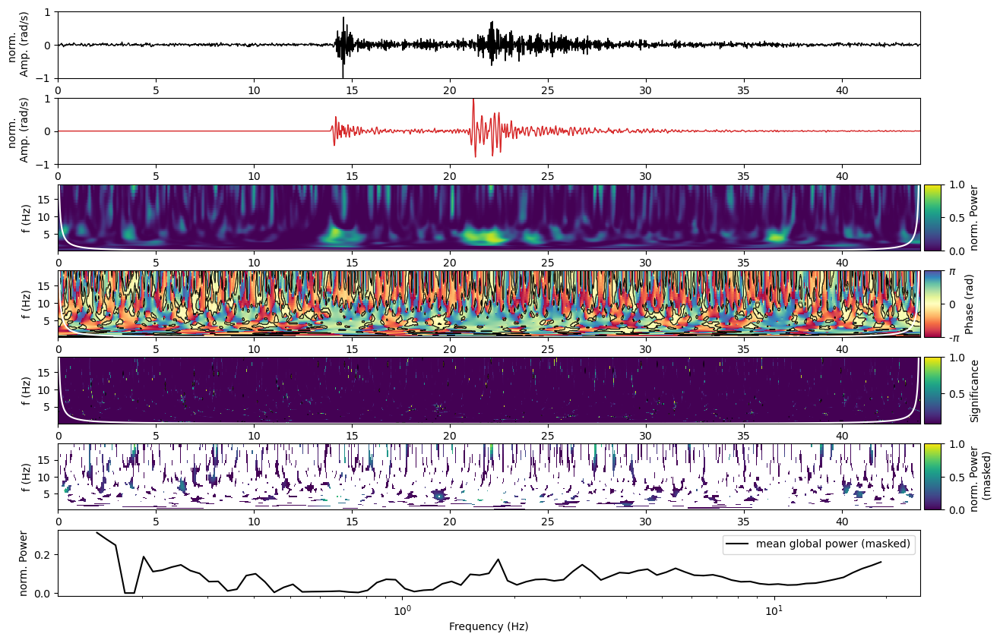


   -> saving /import/kilauea-data/BSPF/figures/wct/20230426_064658_wct_E.png ...

   -> Done



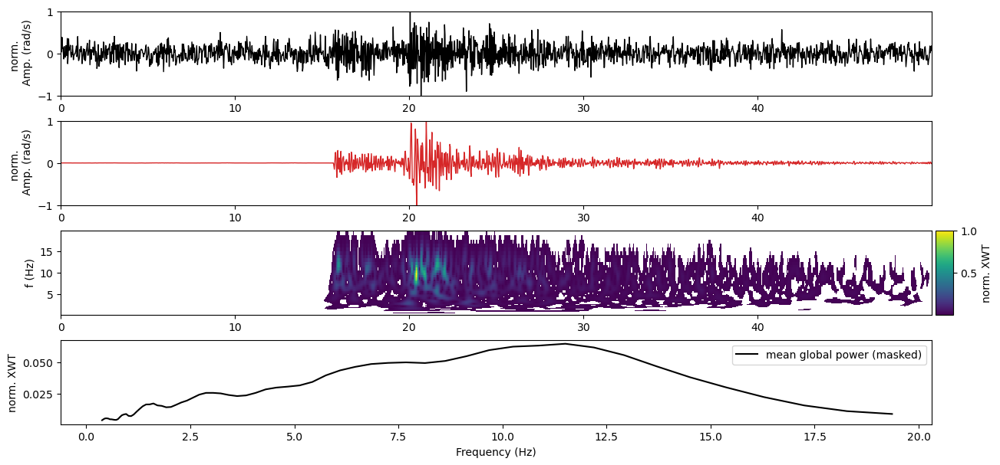


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230503_211420_xwt_Z.png ...

   -> Done



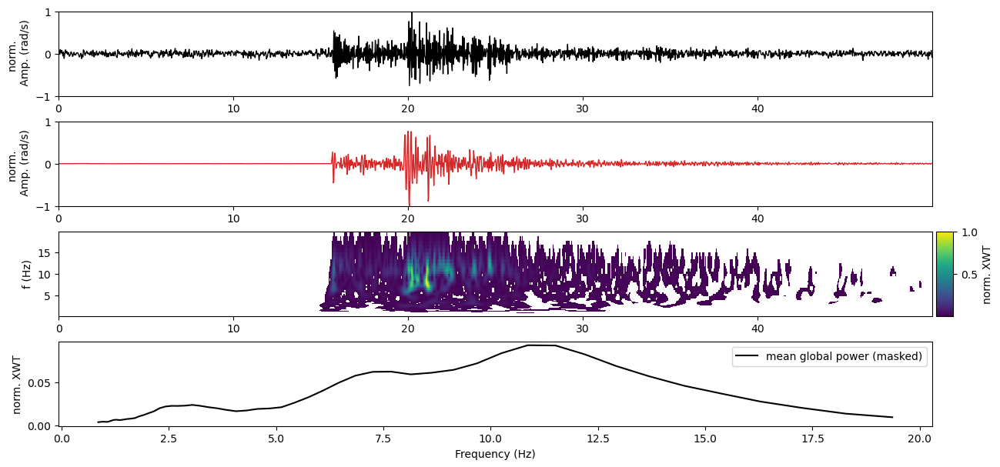


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230503_211420_xwt_N.png ...

   -> Done



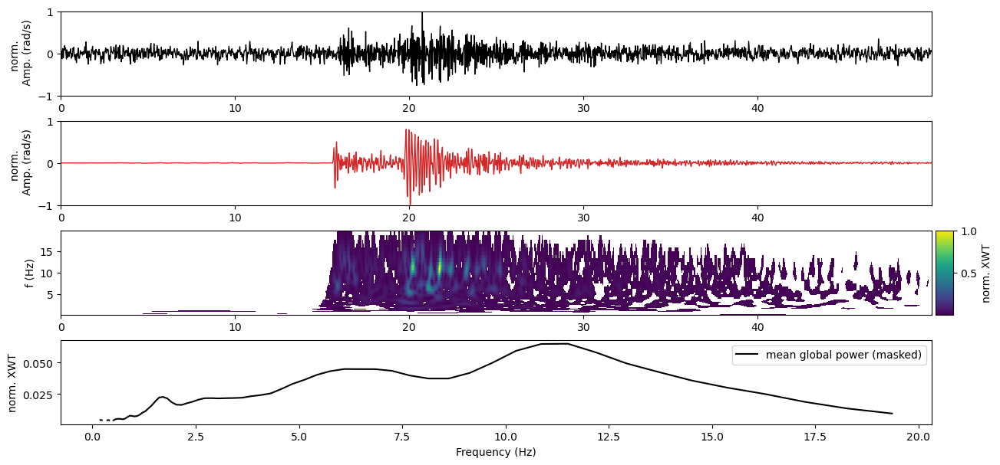


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230503_211420_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.03908613657815775 0.011572326559248981


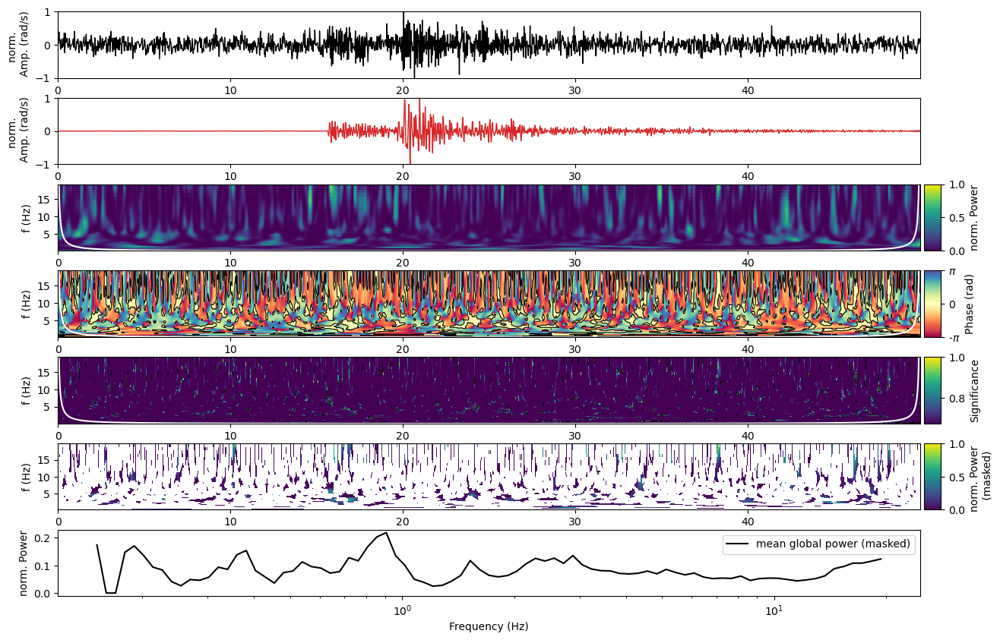


   -> saving /import/kilauea-data/BSPF/figures/wct/20230503_211420_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.015155609922180669 0.009124601692148536


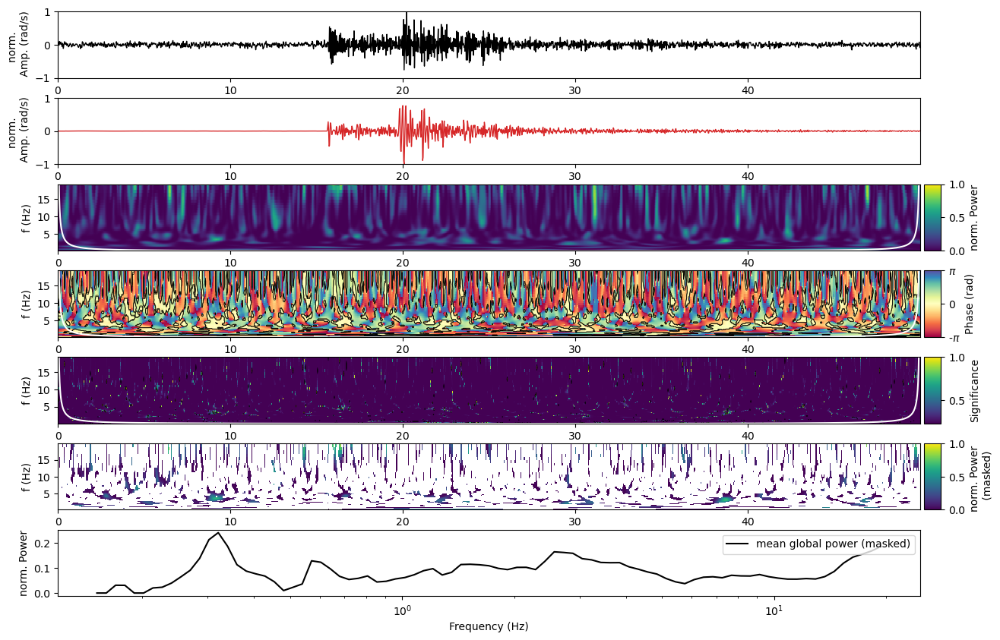


   -> saving /import/kilauea-data/BSPF/figures/wct/20230503_211420_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.02151547230826151 0.012969568874450145


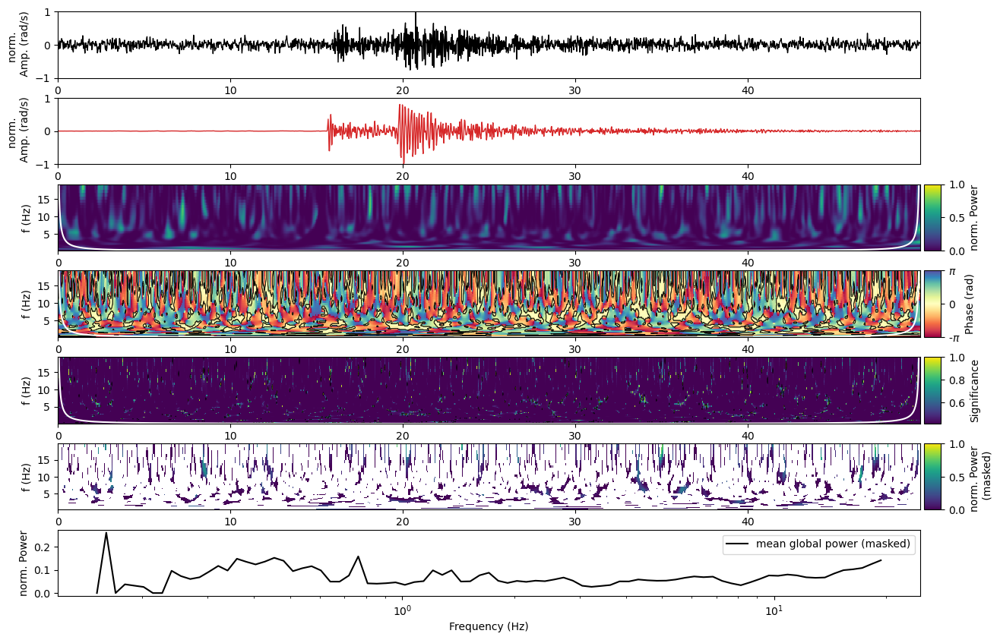


   -> saving /import/kilauea-data/BSPF/figures/wct/20230503_211420_wct_E.png ...

   -> Done



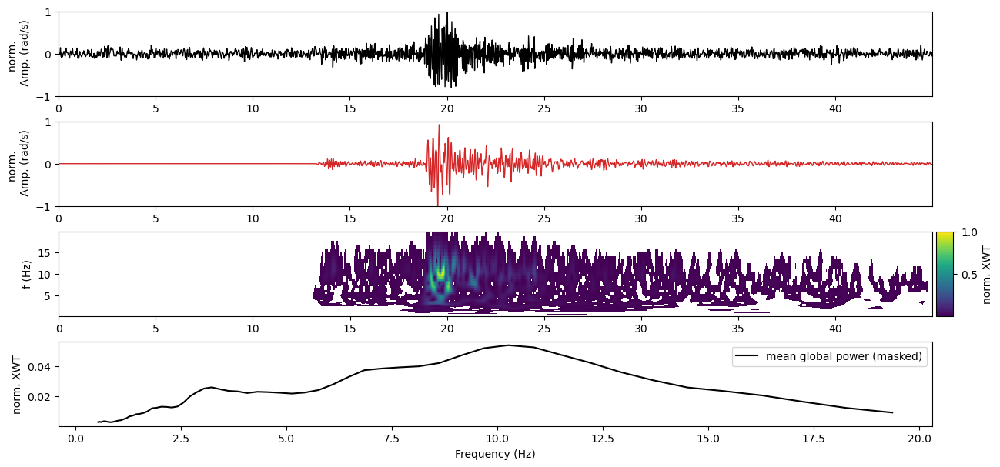


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230520_081816_xwt_Z.png ...

   -> Done



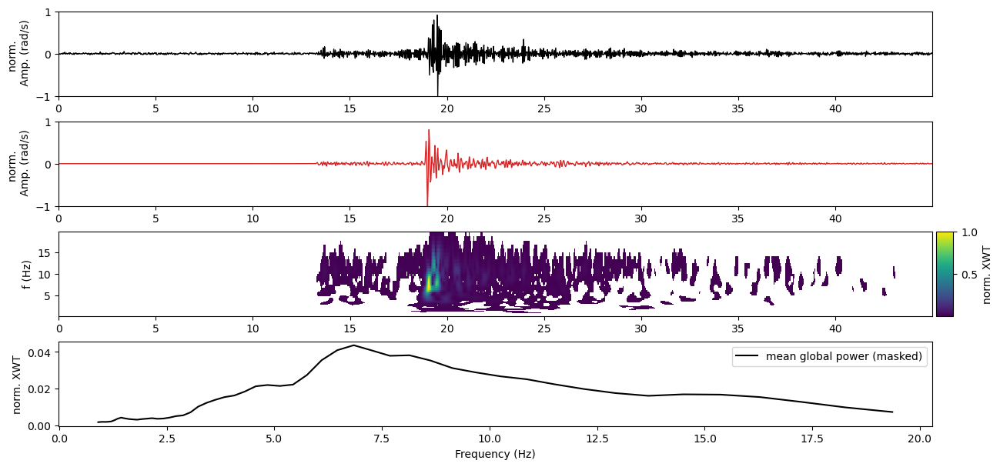


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230520_081816_xwt_N.png ...

   -> Done



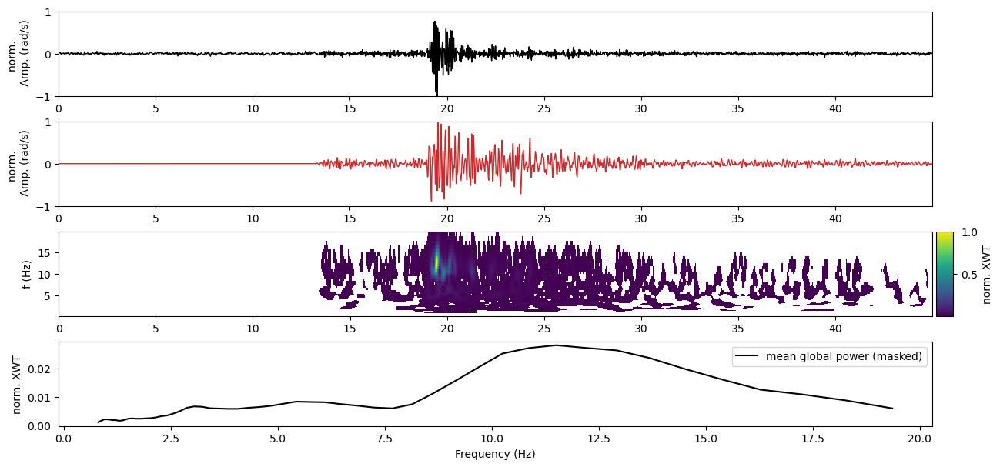


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230520_081816_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.018354010560180333 0.009586063780126133


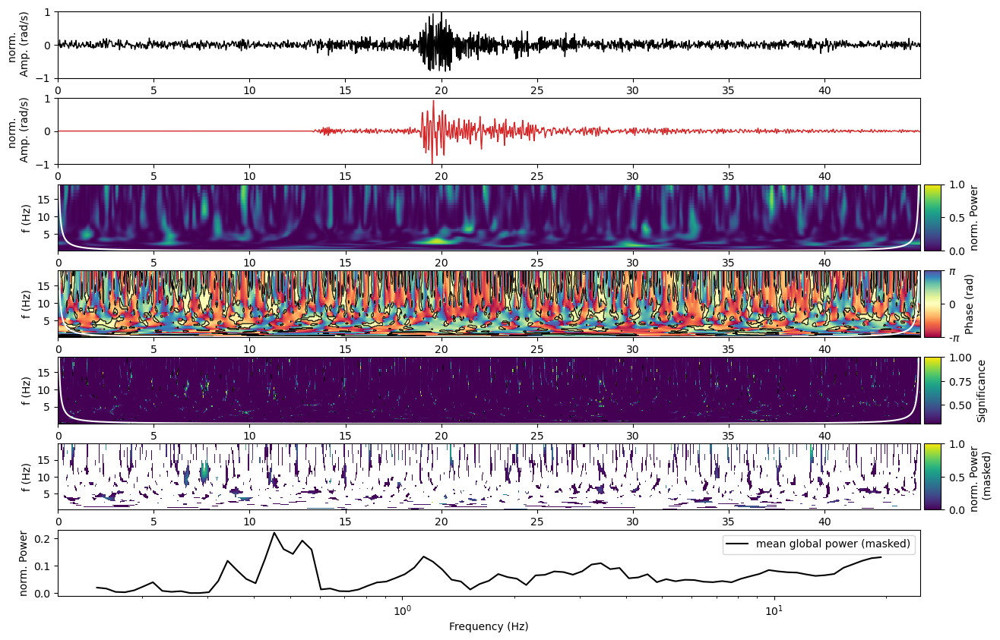


   -> saving /import/kilauea-data/BSPF/figures/wct/20230520_081816_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.006167029935474112 0.003122086537298684


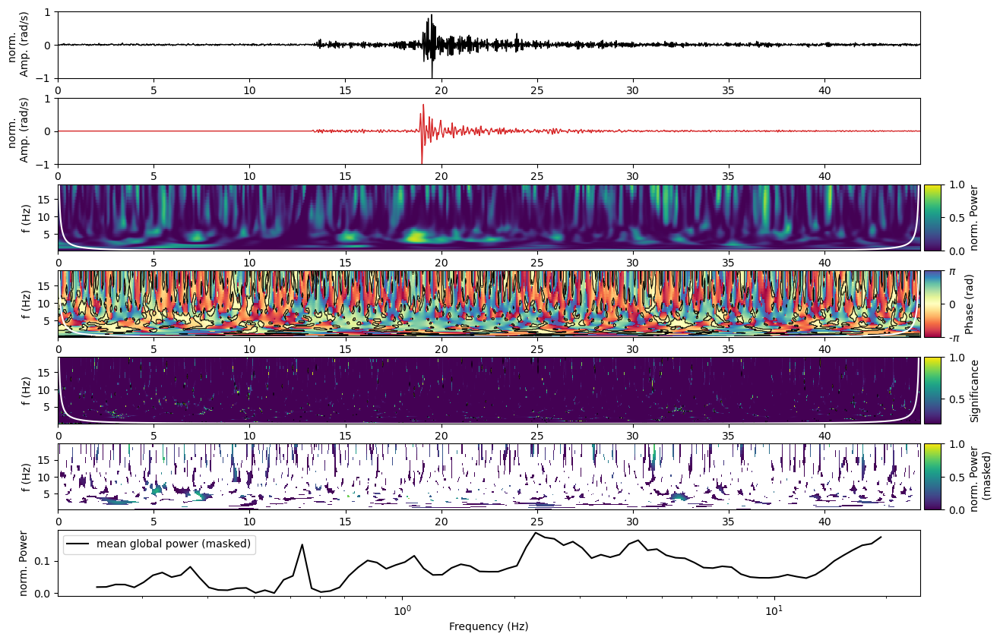


   -> saving /import/kilauea-data/BSPF/figures/wct/20230520_081816_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.006046281989913883 0.016517543342796634


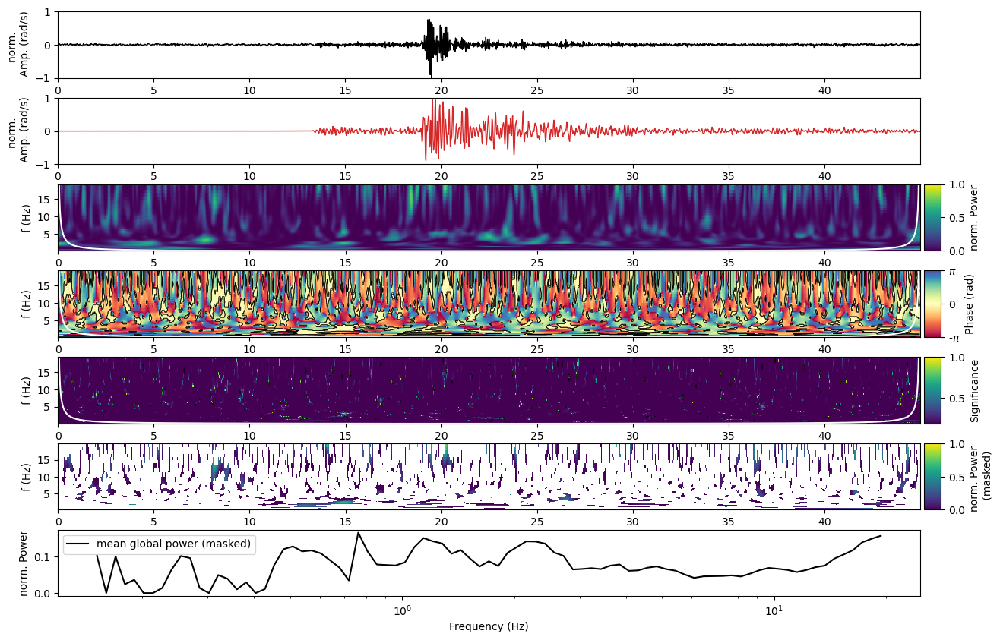


   -> saving /import/kilauea-data/BSPF/figures/wct/20230520_081816_wct_E.png ...

   -> Done



In [13]:

config['eventtime'] = event_time

config['adr_name'] = "inner"  ## inner | all

config['fmin'], config['fmax'] = 0.1, 18


for i in range(0, 17):

    event_time = event_times.origin_time.loc[i]

    try:
        event = events.filter(f"time >= {event_time}",f"time <= {event_time}")
        trig = triggered[triggered.origin == event_time]
    except:
        print(f" -> {i} no event in catalog")


    ## prepare string
    event_time_str = event_time.split(".")[0].replace(" ","_").replace("-","").replace(":","")

    st = obs.read(config['path_to_mseed']+f"*{event_time_str}*");
    st = st.resample(40).trim(st[0].stats.starttime, st[0].stats.endtime);

    st = st.detrend("simple");
    st = st.taper(0.01);
    st = st.filter("bandpass", freqmin=config['fmin'], freqmax=config['fmax'], corners=4, zerophase=True);

    st = st.trim(st[0].stats.starttime+cut_offs[i][0]-10, st[0].stats.endtime-cut_offs[i][1]+10);

    rot = st.select(station="BSPF").copy();

    if config['adr_name'] == "inner":
        adr = st.select(station="RPFO", location="in").copy();
    elif config['adr_name'] == "all":
        adr = st.select(station="RPFO", location="al").copy();


    ## cross wavelet transform
    for comp in ["Z", "N", "E"]:
        out = __compute_cross_wavelet_transform(rot.select(channel=f"*{comp}")[0].times(),
                                                rot.select(channel=f"*{comp}")[0].data,
                                                adr.select(channel=f"*{comp}")[0].data,
                                                rot.select(channel=f"*{comp}")[0].stats.delta,
                                                xwt_threshold=0.1,
                                                normalize=True,
                                                plot=True,
                                               )

        __savefig(out['fig'], config['output_figs'], f"xwt/{event_time_str}_xwt_{comp}", mode="png", dpi=200)

    for comp in ["Z", "N", "E"]:
        out = __compute_wavelet_coherency_transform(rot.select(channel=f"*{comp}")[0].times(),
                                                    rot.select(channel=f"*{comp}")[0].data,
                                                    adr.select(channel=f"*{comp}")[0].data,
                                                    rot.select(channel=f"*{comp}")[0].stats.delta,
                                                    normalize=True,
                                                    plot=True,
                                                   )

        __savefig(out['fig'], config['output_figs'], f"wct/{event_time_str}_wct_{comp}", mode="png", dpi=200)

# df_baz.to_pickle(config['path_to_data']+f"bspf_baz_estimates_{config['rot_name']}.pkl")
# print(f" -> writing: {config['path_to_data']}BSPF_baz_estimates_{config['rot_name']}.pkl")